In [2]:
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt

### Colorscheme

https://www.schemecolor.com/announce.php

In [3]:
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = False
plt.rcParams['axes.spines.left'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['grid.alpha'] = 1.0
plt.rcParams['grid.color'] = '.8'

# Loading the Data

In [4]:
with xr.open_dataset('data/MERRA-2/merged.nc4') as ds:
    ds.load()
    
df = ds.to_dataframe()
df.index.set_names(['lat', 'lon', 'Date'], inplace=True)
df.reset_index(inplace=True)

# take only those values that cover Houston
north, south, east, west = (30.5, 29, -94.5, -96)

filt = (df['lat'] > south) & (df['lat'] < north) & (df['lon'] > west) & (df['lon'] < east)
df = df[filt]

# convert PM2.5 to be in units of micrograms / m^3
df['PM2.5'] = df['PM2.5'] * 1e9

In [5]:
df

,lat,lon,Date,SSSMASS25,DUSCATAU,BCSCATAU,DUEXTTAU,BCFLUXU,OCFLUXV,BCANGSTR,...,SLP,TQV,V2M,TROPQ,V10M,U50M,U10M,QV2M,TROPPV,QV10M
94256,29.5,-95.625,2015-01-01,4.533399e-10,0.002021,0.002087,0.002156,0.000004,0.000019,1.512882,...,102502.109375,33.872681,-2.449461,0.000014,-3.480748,-2.715095,-2.106504,0.005170,12385.588867,0.005072
94257,29.5,-95.625,2015-01-02,6.423546e-10,0.001370,0.002210,0.001459,0.000005,0.000035,1.496467,...,101835.914062,35.265064,-1.914652,0.000012,-2.711771,-1.203307,-0.913161,0.006570,11865.560547,0.006467
94258,29.5,-95.625,2015-01-03,5.319692e-10,0.001622,0.003452,0.001729,0.000011,0.000058,1.491463,...,101459.898438,35.948349,-1.075062,0.000006,-1.526446,3.363282,2.576123,0.007270,11325.949219,0.007129
94259,29.5,-95.625,2015-01-04,9.017004e-10,0.004917,0.001290,0.005263,0.000008,0.000015,1.427629,...,102459.328125,8.960220,-2.824340,0.000018,-4.190116,1.659939,1.085879,0.005313,12323.019531,0.005246
94260,29.5,-95.625,2015-01-05,1.128566e-09,0.001995,0.001070,0.002119,0.000004,0.000009,1.458390,...,103588.531250,4.468480,-2.647162,0.000015,-3.835776,-1.352524,-0.990397,0.003287,13011.084961,0.003148
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
120555,30.0,-95.000,2020-12-27,2.644830e-09,0.004314,0.000919,0.004610,0.000004,-0.000003,1.420772,...,101785.757812,17.180527,1.702342,0.000003,3.421182,-2.415095,-1.175590,0.008967,9196.285156,0.008873
120556,30.0,-95.000,2020-12-28,2.339227e-09,0.003801,0.000975,0.004061,0.000004,0.000005,1.430284,...,102062.609375,21.724472,1.224436,0.000004,2.619898,-2.311006,-1.453111,0.010594,10317.959961,0.010533
120557,30.0,-95.000,2020-12-29,2.954295e-09,0.002281,0.000758,0.002430,0.000004,0.000015,1.418531,...,102127.914062,19.218693,1.293051,0.000003,2.436874,-6.182795,-3.710495,0.009742,9860.671875,0.009654
120558,30.0,-95.000,2020-12-30,5.271861e-09,0.001837,0.000935,0.001960,0.000005,0.000028,1.424324,...,101397.546875,25.310759,1.794293,0.000002,3.386426,-4.566867,-2.814300,0.012001,10461.372070,0.011901


In [6]:
bytes = df.values.nbytes + df.index.nbytes + df.columns.nbytes
print(bytes, bytes/1024, bytes/1024**2)

8137624 7946.8984375 7.760643005371094


In [7]:
train_filt = df['Date'] < '2019-01-01'
val_filt = (df['Date'] > '2018-12-31') & (df['Date'] < '2020-01-01')
test_filt = df['Date'] > '2019-12-31'

def subset_dataframe(df, filt = None):
    features_to_keep = {
        'PS': 'Surface pressure',
        'QV2M': '2-meter specific humidity',
        'QV10M': '10-meter specific humidity',
        'T2M': '2-meter air temperature',
        'T10M' : '10-meter air temperature',
        'U2M': '2-meter eastward wind',
        'V2M': '2-meter northward wind',
        'U50M': '50-meter eastward wind',
        'V50M': '50-meter northward wind',
        'U10M': '10-meter eastward wind',
        'V10M': '10-meter northward wind',
        'TQL': 'Total precipitable liquid water',
        'TQI': 'Total precipitable ice water',
        'TQV': 'Total precipitable water vapor',
        'CLDTOT': 'Total cloud area fraction',
        'PM2.5': 'PM2.5',
        'AODANA': 'Aerosol Optical Depth Analysis',
        'AODINC' : 'Aerosol Optical Depth Analysis Increment',
        'TS' : 'surface skin temperature',
        'Date': 'Date',
        'lat': 'latitude',
        'lon': 'longitude'
    }
    
    if filt is not None:
        df = df[filt]
        
    df = df.loc[:, features_to_keep.keys()] \
        .set_index('Date') \
        .sort_index()
    
    df['Month'] = df.index.month
    return df


train = subset_dataframe(df, train_filt)
val = subset_dataframe(df, val_filt)
test = subset_dataframe(df, test_filt)

In [8]:
train.head()

,PS,QV2M,QV10M,T2M,T10M,U2M,V2M,U50M,V50M,U10M,...,TQI,TQV,CLDTOT,PM2.5,AODANA,AODINC,TS,lat,lon,Month
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,102206.734375,0.005170,0.005072,279.765778,279.664124,-1.503023,-2.449461,-2.715095,-4.357012,-2.106504,...,0.027982,33.872681,0.964355,8.259367,0.140065,-0.000241,280.186188,29.5,-95.625,1
2015-01-01,101955.406250,0.004916,0.004818,278.565674,278.501373,-0.884811,-1.539559,-1.928559,-3.429603,-1.417902,...,0.038740,32.573849,0.961823,7.695491,0.134578,-0.000058,278.810760,30.0,-95.625,1
2015-01-01,102225.734375,0.005039,0.004922,279.140472,279.059967,-1.089089,-1.274900,-2.462842,-3.091021,-1.772416,...,0.031797,32.869099,0.959483,7.260243,0.127884,-0.000094,279.645569,30.0,-95.000,1
2015-01-01,102381.406250,0.005820,0.005627,281.634613,281.458069,-2.752680,-2.887856,-4.209060,-4.346270,-3.456308,...,0.024823,34.214149,0.967845,8.722021,0.135506,-0.000472,283.206757,29.5,-95.000,1
2015-01-02,101544.734375,0.006570,0.006467,282.227631,282.130585,-0.656459,-1.914652,-1.203307,-3.412587,-0.913161,...,0.043295,35.265064,0.932393,17.585114,0.206579,0.004601,282.719147,29.5,-95.625,1


# Useful Functions

## Utility

In [153]:
from sklearn.model_selection import StratifiedKFold

def stratified_kfold(x, y, k=10):
    # stratified k-fold cross validation: https://stackoverflow.com/a/54946733/5217293
    y_cat = pd.cut(y, k, labels=range(k))
    return StratifiedKFold(k).split(x, y_cat)

def summarize_scores(scores):
    r2 = scores["test_r2"].mean()
    mae = np.abs(scores["test_neg_mean_absolute_error"]).mean()
    rmse = np.abs(scores["test_neg_root_mean_squared_error"]).mean()
    return r2, mae, rmse
    
def print_scores(scores):
    r2, mae, rmse = summarize_scores(scores)
    
    print('R2, MAE, RMSE')
    print(f'{r2:.2f}, {mae:.2f}, {rmse:.2f}')

## Plotting

In [339]:
from sklearn import preprocessing
import scipy.stats as stats

def histogram_density_plot(df, nbins = 30, by = None, title = None, bin_fontsize = 8, tick_fontsize=6, xlabel=None, ylabel=None, dpi=600, xmin=0, ax = None, xlim = None):
    if ax is None:
        fig, ax = plt.subplots(dpi=dpi)

    density = stats.kde.gaussian_kde(df[by].values)
    x = np.arange(xmin, df[by].values.max(), .1)
    density = density(x)

    ax.plot(x, density, alpha=0.7, lw=1, color='#9CDEF6')
    ax.fill_between(x, density, alpha=0.4, color='#9CDEF6')

    n, bins, patches = ax.hist(df[by], bins=nbins, rwidth=0.75, density=True, alpha=0.7, zorder=3, color='#6549DA')
    ax.set_xticks(bins)
    counts = df[by].value_counts(bins=nbins, sort=False)
    for count, bar in zip(counts, patches):
        ax.text(bar.get_x() + bar.get_width()/2, bar.get_height()+.0005, f'{count}', fontsize=bin_fontsize, ha='center')

    if xlim is None:
        ax.set_xlim((xmin, df[by].values.max()))
    else:
        ax.set_xlim(xlim)
        
    ax.tick_params(axis='both', labelsize=tick_fontsize, width=0, which='both')
    ax.grid(True, alpha=0.2)
    
    if title is not None:
        ax.set_title(title)
    
    if xlabel is not None:
        ax.set_xlabel(xlabel)
        
    if ylabel is not None:
        ax.set_ylabel(ylabel)
    
    return bins

In [21]:
from yellowbrick.regressor import ResidualsPlot

def residuals_plot(model, x, y, unseen_x, unseen_y, unseen_label = 'Validation', train_color='#9CDEF6', test_color='#6549DA'):
    fig, ax = plt.subplots(dpi=300)

    visualizer = ResidualsPlot(model, ax=ax, hist=False, qqplot=True, 
                              train_alpha=0.5, 
                              test_alpha=0.5,
                              train_color=train_color,
                              test_color=test_color,
                              is_fitted=True)

    visualizer.fit(x, y)  # Fit the training data to the visualizer
    visualizer.score(unseen_x, unseen_y)  # Evaluate the model on the test data

    for _ax in fig.get_axes():
        _ax.tick_params(axis='both', labelsize=10, width=0, which='both')
        _ax.grid(True, alpha=0.2)

    visualizer._labels = [i.replace('Test', unseen_label) for i in visualizer._labels]
    visualizer.show()    

In [234]:
def score_boxplot(score_type, *args, title='', labels=None, ax=None, tick_fontsize=10, title_fontsize=20, take_absolute_value=False):
    if labels is None:
        raise ValueError("Provide labels")
    scores = [arg[score_type] for arg in args]
    
    if take_absolute_value:
        scores = list(map(np.abs, scores))
    
    if ax is None:
        fig, ax = plt.subplots(dpi=300)
    
    boxes = ax.boxplot(scores, labels=labels, vert=False, showmeans=True)
    
    ax.set_title(title, fontsize=title_fontsize)
    
    ax.tick_params(axis='both', labelsize=tick_fontsize, width=0, which='both')
    ax.grid(True, alpha=0.5)
    
    return boxes

In [232]:
from matplotlib.gridspec import GridSpec

def grouped_boxplot_with_table(scores, labels):
    fig = plt.figure(figsize=(10, 5.0), dpi=300)

    gs = GridSpec(2, 3, figure=fig)
    ax1 = fig.add_subplot(gs[0, 0])
    ax2 = fig.add_subplot(gs[0, 1])
    ax3 = fig.add_subplot(gs[0, 2])
    ax4 = fig.add_subplot(gs[1, :])

    fs=10

    r2_boxes = score_boxplot('test_r2', *scores, 
                  title='$R^2$', labels=labels, ax=ax1, 
                  tick_fontsize=fs)

    mae_boxes = score_boxplot('test_neg_mean_absolute_error', *scores, 
                  title='MAE', labels=labels, ax=ax2, 
                  tick_fontsize=fs, take_absolute_value=True)

    rmse_boxes = score_boxplot('test_neg_root_mean_squared_error', *scores, 
                  title='RMSE', labels=labels, ax=ax3, 
                  tick_fontsize=fs, take_absolute_value=True)

    for boxes in [r2_boxes, mae_boxes, rmse_boxes]:
        for mean in boxes['means']:
            mean.set_markerfacecolor('#A86CAD')
        for median in boxes['medians']:
            median.set_color('#FCA481')

    ax1.invert_yaxis()
    ax2.invert_yaxis()
    ax3.invert_yaxis()

    ax2.set_yticklabels([])
    ax3.set_yticklabels([])

    plt.rc('text', usetex=True)
    ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
    ax3.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

    ax4.axis('off')
    ax4.axis('tight')

    cell_text = []
    for score in scores:
        vals = [f'{i:.2f}' for i in summarize_scores(score)]
        cell_text.append(vals)

    table = ax4.table(cellText=cell_text,
                          rowLabels=labels,
                          colLabels=['$R^2$', 'MAE', 'RMSE'],
                          loc='best', edges='open', cellLoc='center')

    fig.tight_layout()

In [170]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression

def plot_residuals(model, title):
    """
    Plot the residuals of the mixed effect model
    
    Parameters
    ----------
    model : MixedLMWrapper
        A fitted MixedLMWrapper model
    title : string
        The title to place on the plot
    """
    fig, ax = plt.subplots(dpi=300)

    ax.scatter(
        model.results_.resid.index, 
        model.results_.resid, 
        alpha=0.25, color='#9CDEF6', edgecolors='#6549DA')
    ax.set_title(title);
    
def plot_prediction_error(model, x, y, legend_fontsize = 12, unity_color = '#A86CAD', fit_color = '#FCA481', r2_ax_locx = .1, r2_ax_locy = .82, dropped_spines = False):
    """
    Plot true values of y against the predicted values, y_hat, made by the model
    
    
    Parameters
    ----------
    model : an sklearn-like fitted model
        A fitted model
    x : array_like
        The data used to predict y
    y : array_like
        The data being predicted
    legend_fontsize : int, optional default 12
        The fontsize in points
    unity_color : string, optional default '#A86CAD'
        The color used to paint the line y = x
    fit_color : string, optional default '#FCA481'
        The color used to paint the fit line made by a linear regression of y_hat ~ y
    r2_ax_locx : float, optional default .1
        The x position of the r squared label on the graph in axes coordinates
    r2_ax_locy : float, optional default .82
        The y position of the r squared label on the graph in axes coordinates
    dropped_spines : boolean, optional default False
        If set to true, the bottom and left spines will be drawn and offset 
        and the grid will be turned off
    """
    y_hat = model.predict(x)

    fit = LinearRegression().fit(y.values.reshape(-1, 1), y_hat.values)

    fit_r2 = fit.score(y.values.reshape(-1, 1), y_hat.values)
    equation = f'y = {fit.coef_[0]:.2f} x + {fit.intercept_:.2f}'

    line = np.arange(0, y_val.max(), 1)
    
    fig, ax = plt.subplots(dpi=300)

    ax.plot(line, line, '--', color=unity_color, lw=1, label='unity')
    ax.plot(line, fit.predict(line.reshape(-1, 1)), color=fit_color, lw=1, label=equation)

    ax.scatter(y, y_hat, alpha=0.5, color='#9CDEF6', edgecolors='#6549DA')

    ax.text(r2_ax_locx, r2_ax_locy, fr'$R^2 ={fit_r2:.2f}$', transform=ax.transAxes, fontdict={'fontsize': legend_fontsize})

    mae = mean_absolute_error(y, y_hat)
    rmse = mean_squared_error(y, y_hat, squared=False)
    r2 = r2_score(y, y_hat)

    ax.set_title(f'MAE = {mae:.2f}' + r' $\frac{\mu g}{m^3}$' + f'  RMSE = {rmse:.2f}' + r' $\frac{\mu g}{m^3}$')

    ax.set_xlabel(r'True $[PM_{2.5}]~ \frac{\mu g}{m^3}$')
    ax.set_ylabel(r'Predicted $[PM_{2.5}]~ \frac{\mu g}{m^3}$')

    ax.legend(fontsize=legend_fontsize)
    
    round_up = lambda num, divisor: np.ceil(num / divisor) * divisor
    
    if dropped_spines:
        ax.set_xlim((0, round_up(y_val.max(), 10)))
        ax.set_ylim((0, round_up(y_hat.max(), 10)))
        
        ax.grid(False)
        
        ax.spines['left'].set_visible(True)
        ax.spines['left'].set_position(('outward', 10))
        
        ax.spines['bottom'].set_visible(True)
        ax.spines['bottom'].set_position(('outward', 10))
        
        ax.tick_params(direction='out', length=4, width=1, color='.8')

# Visualizing PM2.5

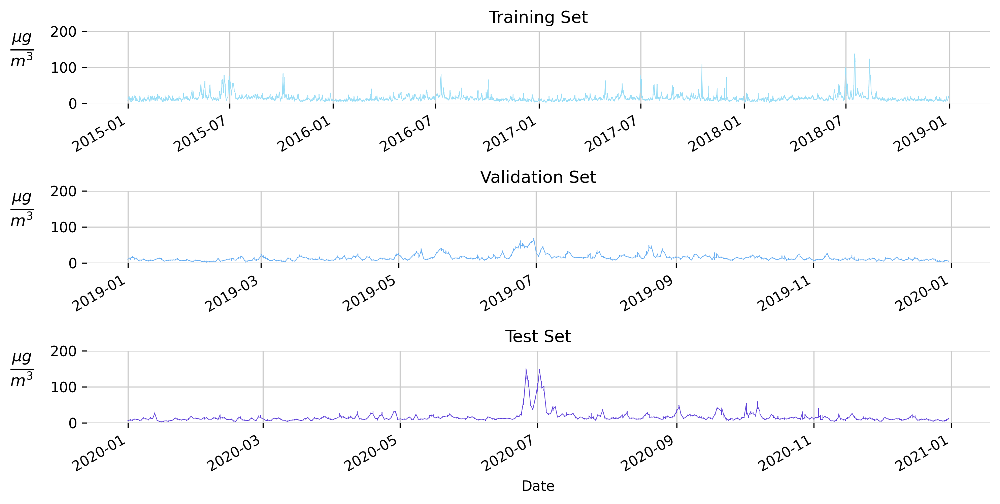

In [15]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(10, 5.09), dpi=300)

train['PM2.5'].plot(ax = ax1, lw=.5, color='#9CDEF6')
val['PM2.5'].plot(ax = ax2, lw=.5, color='#6CB0F2')
test['PM2.5'].plot(ax = ax3, lw=.5, color='#6549DA')

ax1.set_xlabel('')
ax2.set_xlabel('')

ax1.set_title('Training Set')
ax2.set_title('Validation Set')
ax3.set_title('Test Set')

for ax in [ax1, ax2, ax3]:
    ax.set_ylabel(r'$\frac{\mu g}{m^3}$', rotation=0, fontsize=16, labelpad=20)
    ax.grid(True)
    ax.set_ylim((0, 200))
    
fig.tight_layout()

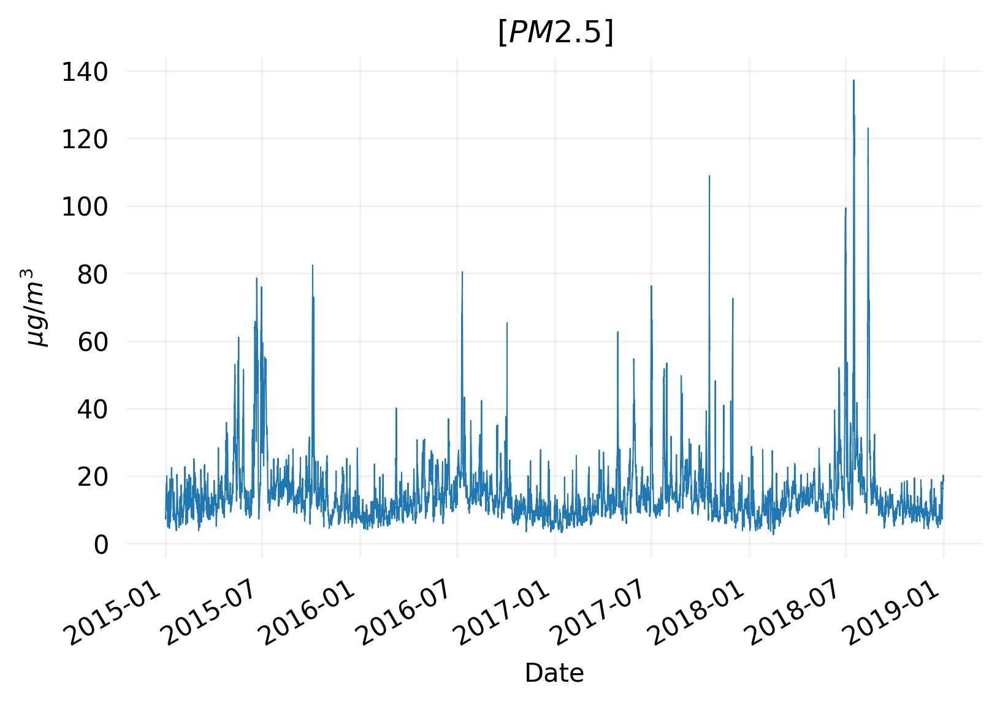

In [16]:
fig, ax = plt.subplots(dpi=300)

# train.resample('D').mean().plot(y='PM2.5', ax=ax, lw=0.5, legend=False)
train.plot(y='PM2.5', ax=ax, lw=0.5, legend=False)

# ax.axvspan(pd.Timestamp('2018-07-01'), pd.Timestamp('2018-07-30'), color='red', alpha=0.4)

ax.tick_params(axis='both', labelsize=10, width=0, which='both')
ax.grid(True, alpha=0.25)

ax.set_ylabel(r'$\mu g/m^3$')

ax.set_title('$[PM2.5]$');

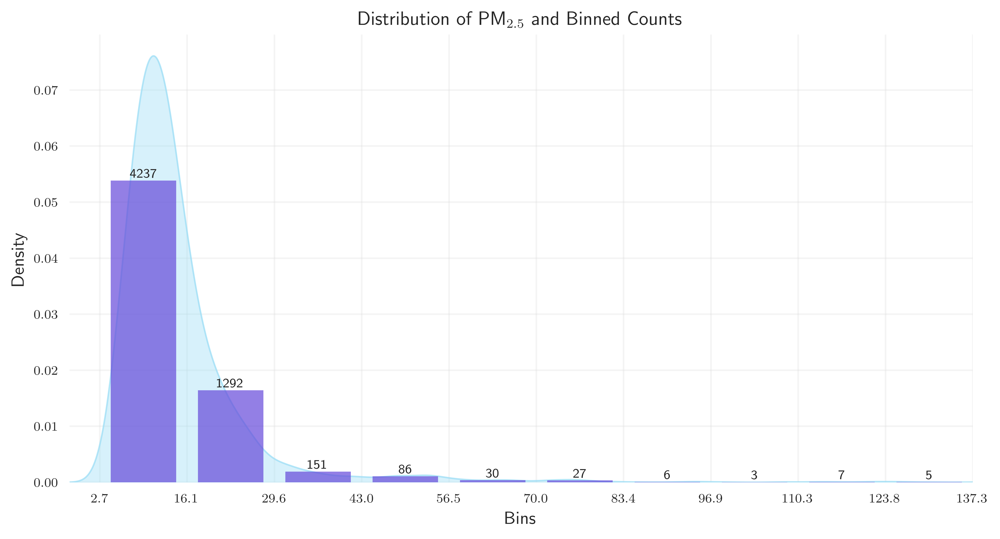

In [340]:
# daily = train.resample('D').mean()

fig, ax = plt.subplots(dpi = 600, figsize=(10, 5.09))

bins = histogram_density_plot(train, 
                       by='PM2.5', 
                       nbins=10, 
                       title="Distribution of PM$_{2.5}$ and Binned Counts", 
                       tick_fontsize=8,
                       dpi=600,
                       xlabel='Bins',
                       ylabel='Density',
                       xmin=-2, 
                       ax=ax)

In [41]:
train

,PS,QV2M,QV10M,T2M,T10M,U2M,V2M,U50M,V50M,U10M,...,TQI,TQV,CLDTOT,PM2.5,AODANA,AODINC,TS,lat,lon,Month
Date,,,,,,,,,,,,,,,,,,,,,
2015-01-01,102206.73,0.01,0.01,279.77,279.66,-1.50,-2.45,-2.72,-4.36,-2.11,...,0.03,33.87,0.96,8.26,0.14,-0.00,280.19,29.50,-95.62,1
2015-01-01,101955.41,0.00,0.00,278.57,278.50,-0.88,-1.54,-1.93,-3.43,-1.42,...,0.04,32.57,0.96,7.70,0.13,-0.00,278.81,30.00,-95.62,1
2015-01-01,102225.73,0.01,0.00,279.14,279.06,-1.09,-1.27,-2.46,-3.09,-1.77,...,0.03,32.87,0.96,7.26,0.13,-0.00,279.65,30.00,-95.00,1
2015-01-01,102381.41,0.01,0.01,281.63,281.46,-2.75,-2.89,-4.21,-4.35,-3.46,...,0.02,34.21,0.97,8.72,0.14,-0.00,283.21,29.50,-95.00,1
2015-01-02,101544.73,0.01,0.01,282.23,282.13,-0.66,-1.91,-1.20,-3.41,-0.91,...,0.04,35.27,0.93,17.59,0.21,0.00,282.72,29.50,-95.62,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-30,101608.48,0.01,0.01,281.96,281.81,-0.21,-2.44,-0.47,-4.27,-0.30,...,0.06,36.12,0.96,17.48,0.40,0.00,282.57,29.50,-95.62,12
2018-12-31,101199.45,0.01,0.01,284.40,284.38,2.24,-0.08,3.55,-0.01,2.88,...,0.04,30.30,0.94,18.68,0.20,0.00,285.28,29.50,-95.00,12
2018-12-31,101027.45,0.01,0.01,282.82,282.80,1.67,0.02,3.11,0.01,2.38,...,0.05,27.94,0.93,18.65,0.21,0.00,283.12,29.50,-95.62,12


# Feature Selection

In [17]:
from sklearn.feature_selection import mutual_info_regression, SelectKBest

X, y = train.drop('PM2.5', axis=1), train['PM2.5']


features = SelectKBest(mutual_info_regression, k=10)
features.fit(X, y)

x = X.loc[:, features.get_support()]
X_val, y_val = val.drop('PM2.5', axis=1).loc[:, features.get_support()], val['PM2.5']

pd.options.display.float_format = '{:.2f}'.format

translations = {
    'PS': 'Surface pressure',
    'QV2M': '2-meter specific humidity',
    'QV10M': '10-meter specific humidity',
    'T2M': '2-meter air temperature',
    'T10M' : '10-meter air temperature',
    'U2M': '2-meter eastward wind',
    'V2M': '2-meter northward wind',
    'U50M': '50-meter eastward wind',
    'V50M': '50-meter northward wind',
    'U10M': '10-meter eastward wind',
    'V10M': '10-meter northward wind',
    'TQL': 'Total precipitable liquid water',
    'TQI': 'Total precipitable ice water',
    'TQV': 'Total precipitable water vapor',
    'CLDTOT': 'Total cloud area fraction',
    'PM2.5': 'PM2.5',
    'AODANA': 'Aerosol Optical Depth Analysis',
    'AODINC' : 'Aerosol Optical Depth Analysis Increment',
    'TO3' : 'total column ozone',
    'TS' : 'surface skin temperature',
    'Date': 'Date',
    'lat': 'latitude',
    'lon': 'longitude'
}

In [18]:
x.rename(translations, axis=1)

,Surface pressure,2-meter specific humidity,10-meter specific humidity,2-meter air temperature,10-meter air temperature,Total precipitable ice water,Total precipitable water vapor,Aerosol Optical Depth Analysis,surface skin temperature,Month
Date,,,,,,,,,,
2015-01-01,102206.73,0.01,0.01,279.77,279.66,0.03,33.87,0.14,280.19,1
2015-01-01,101955.41,0.00,0.00,278.57,278.50,0.04,32.57,0.13,278.81,1
2015-01-01,102225.73,0.01,0.00,279.14,279.06,0.03,32.87,0.13,279.65,1
2015-01-01,102381.41,0.01,0.01,281.63,281.46,0.02,34.21,0.14,283.21,1
2015-01-02,101544.73,0.01,0.01,282.23,282.13,0.04,35.27,0.21,282.72,1
...,...,...,...,...,...,...,...,...,...,...
2018-12-30,101608.48,0.01,0.01,281.96,281.81,0.06,36.12,0.40,282.57,12
2018-12-31,101199.45,0.01,0.01,284.40,284.38,0.04,30.30,0.20,285.28,12
2018-12-31,101027.45,0.01,0.01,282.82,282.80,0.05,27.94,0.21,283.12,12


In [12]:
y.describe()

count   5844.00
mean      14.94
std       10.98
min        2.65
25%        9.33
50%       12.41
75%       16.66
max      137.26
Name: PM2.5, dtype: float64

In [19]:
X_val, y_val = val.drop('PM2.5', axis=1), val['PM2.5']

X_val = X_val.loc[:, features.get_support()]

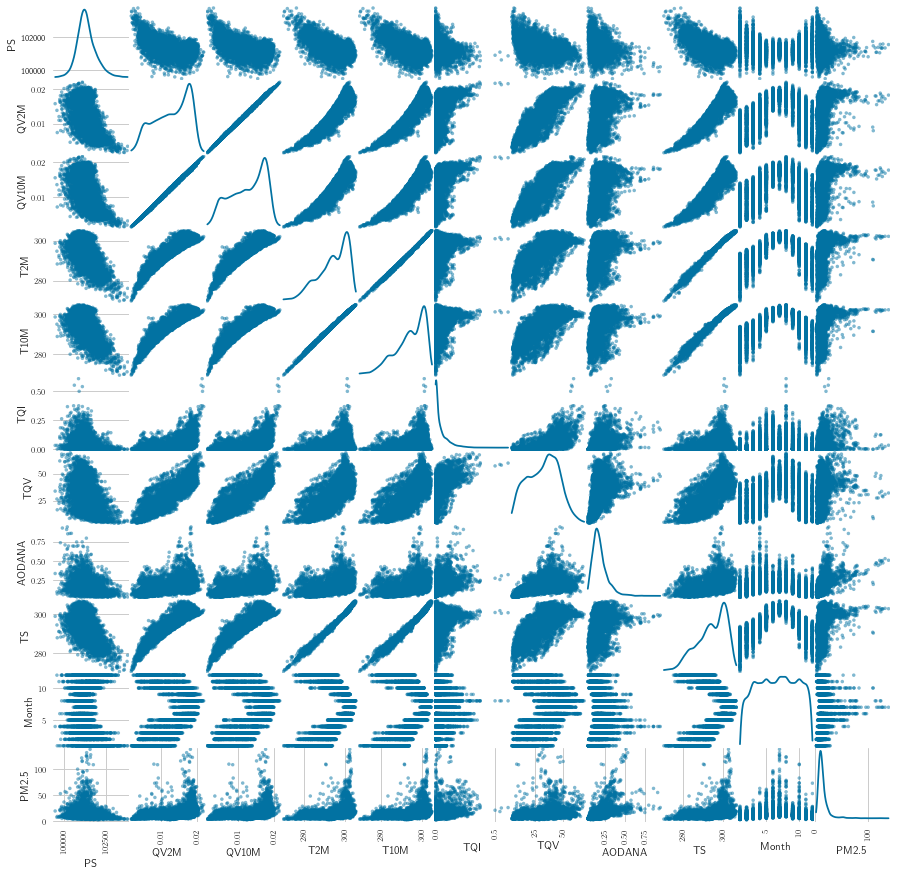

In [441]:
from pandas.plotting import scatter_matrix

subset = train.loc[:, x.columns.values.tolist() + ['PM2.5']]
# subset['PM2.5'] = np.log(subset['PM2.5'])

scatter_matrix(subset,
               alpha=.5, figsize=(15, 15), diagonal='kde');

# Cross-validation Setup

In [26]:
scoring=['r2', 'neg_mean_absolute_error', 'neg_root_mean_squared_error']

## Regular 10-Fold Cross-validation

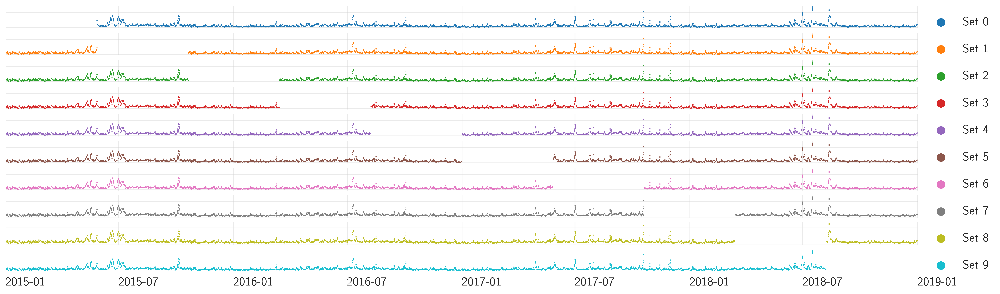

In [264]:
from matplotlib.pyplot import cm
import datetime
from sklearn.model_selection import KFold

counts = {i: [] for i in range(10)}

fig, axes = plt.subplots(10, 1, figsize=(20, 6), dpi=600)

color=iter(cm.tab10(np.linspace(0,1,10)))

dstart = datetime.datetime(2015,1,1)
dend = datetime.datetime(2019,1,1)

for idx, ((train_idx, test_idx), ax) in enumerate(zip(KFold(n_splits=10).split(x), axes)):
    _y = y.iloc[train_idx]
    ax.scatter(_y.index, _y, label=f'Set {idx}', color=next(color), s=1)
    c = pd.cut(_y, bins=bins, labels=range(10), ordered=False).value_counts()
    for i in range(10):
        counts[i].append(c.loc[i])
        
    ax.legend(bbox_to_anchor=(1,1), loc="upper left", fontsize=15, markerscale=10)
    
    ax.set_xlabel('')
    ax.set_yticklabels([])
    ax.set_xlim((dstart, dend))
    ax.grid(alpha=0.4)
        
for ax in axes[:-1]:
    ax.set_xticklabels([])
    ax.grid(True)
    
axes[-1].tick_params(axis='x', labelsize=15, rotation=0)

for tick in axes[-1].xaxis.get_majorticklabels():
    tick.set_horizontalalignment("left")


## Stratified 10-Fold Cross-validation

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


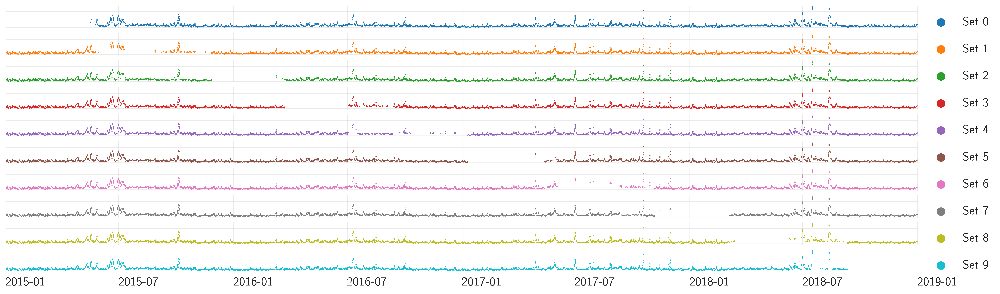

In [263]:
from matplotlib.pyplot import cm
import datetime

counts = {i: [] for i in range(10)}

fig, axes = plt.subplots(10, 1, figsize=(20, 6), dpi=600)

color=iter(cm.tab10(np.linspace(0,1,10)))

dstart = datetime.datetime(2015,1,1)
dend = datetime.datetime(2019,1,1)

for idx, ((train_idx, test_idx), ax) in enumerate(zip(stratified_kfold(x, y, 10), axes)):
    _y = y.iloc[train_idx]
    ax.scatter(_y.index, _y, label=f'Set {idx}', color=next(color), s=1)
    c = pd.cut(_y, bins=bins, labels=range(10), ordered=False).value_counts()
    for i in range(10):
        counts[i].append(c.loc[i])
        
    ax.legend(bbox_to_anchor=(1,1), loc="upper left", fontsize=15, markerscale=10)
    
    ax.set_xlabel('')
    ax.set_yticklabels([])
    ax.set_xlim((dstart, dend))
    ax.grid(alpha=0.4)
        
for ax in axes[:-1]:
    ax.set_xticklabels([])
    ax.grid(True)
    
axes[-1].tick_params(axis='x', labelsize=15, rotation=0)

for tick in axes[-1].xaxis.get_majorticklabels():
    tick.set_horizontalalignment("left")


In [18]:
bin_counts = pd.DataFrame(counts, index=[f'Set {i}' for i in range(10)])
bin_counts.columns = vals
bin_counts = bin_counts.T
bin_counts.index = bin_counts.index.set_names('Bin Range microgram/m3')
bin_counts

,Set 0,Set 1,Set 2,Set 3,Set 4,Set 5,Set 6,Set 7,Set 8,Set 9
Bin Range microgram/m3,,,,,,,,,,
2.7 - 16.1,3812,3812,3812,3812,3812,3812,3812,3814,3813,3813
16.1 - 29.6,1163,1163,1163,1163,1163,1163,1163,1162,1162,1163
29.6 - 43.0,136,136,136,136,136,136,136,136,136,135
43.0 - 56.5,77,77,77,77,77,77,78,78,78,78
56.5 - 70.0,27,27,27,27,27,27,27,27,27,27
70.0 - 83.4,24,24,24,25,25,25,24,24,24,24
83.4 - 96.9,5,5,6,6,6,6,5,5,5,5
96.9 - 110.3,3,3,3,2,2,2,3,3,3,3
110.3 - 123.8,7,7,6,6,6,6,6,6,6,7


# Linear Models

## Ordinary Least Squares

In [143]:
%%time

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, cross_validate

lm = LinearRegression()

reg_scores = cross_validate(lm, x, y, 
                            cv=stratified_kfold(x, y, 10), 
                            scoring=scoring)

lm.fit(x, y)

print_scores(reg_scores)

R2, MAE, RMSE
0.34, 5.00, 8.81
CPU times: user 157 ms, sys: 22.6 ms, total: 179 ms
Wall time: 66.3 ms


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


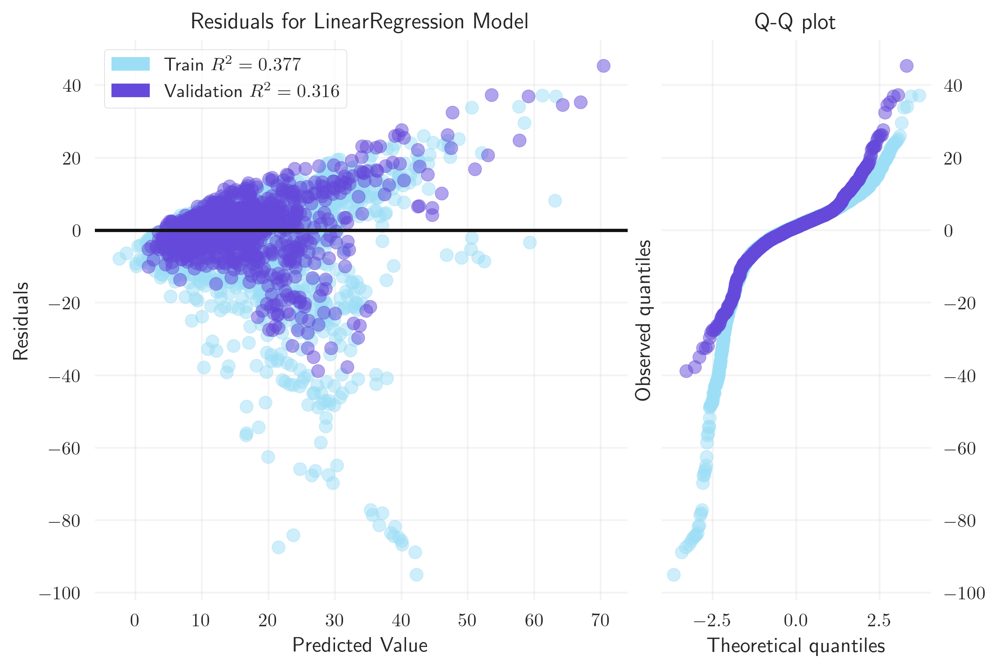

In [144]:
residuals_plot(lm, x, y, X_val, y_val)

## Elastic Net

In [118]:
%%time

from sklearn.linear_model import ElasticNetCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

elastic = ElasticNetCV(cv=10, 
                       l1_ratio=np.arange(0.1, 1.1, .1),
                       max_iter=10000
                      )

elastic_pipe = Pipeline([('scaler', StandardScaler()), ('elastic', elastic)])

elastic_scores = cross_validate(elastic_pipe, x, y, 
                                cv=stratified_kfold(x, y, 10), 
                                scoring=scoring)

elastic_pipe.fit(x, y)

print_scores(elastic_scores)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.34, 4.91, 8.83


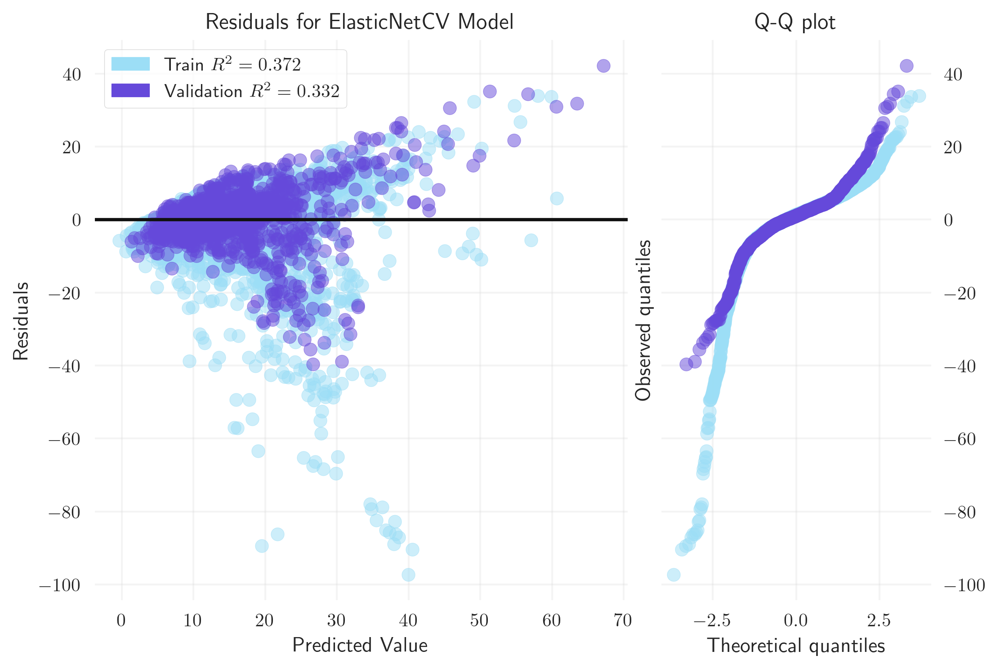

In [135]:
residuals_plot(elastic_pipe, x, y, X_val, y_val)

## Polynomial Regression

In [145]:
%%time

from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import GridSearchCV

polynomial_pipe = Pipeline([('poly', PolynomialFeatures()),
                  ('linear', LinearRegression())]) 

params={'poly__degree': [1, 2, 3]}

poly_grid = GridSearchCV(polynomial_pipe, params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

poly_grid.fit(x, y)

polynomial_scores = cross_validate(poly_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(x, y, 10), 
                                scoring=scoring)

print_scores(polynomial_scores)
print(poly_grid.best_params_)
print(poly_grid.best_estimator_.named_steps['poly'].get_feature_names(x.columns))
print(poly_grid.best_estimator_.named_steps['linear'].coef_)

R2, MAE, RMSE
0.49, 4.78, 7.76
{'poly__degree': 2}
['1', 'PS', 'QV2M', 'QV10M', 'T2M', 'T10M', 'TQI', 'TQV', 'AODANA', 'TS', 'Month', 'PS^2', 'PS QV2M', 'PS QV10M', 'PS T2M', 'PS T10M', 'PS TQI', 'PS TQV', 'PS AODANA', 'PS TS', 'PS Month', 'QV2M^2', 'QV2M QV10M', 'QV2M T2M', 'QV2M T10M', 'QV2M TQI', 'QV2M TQV', 'QV2M AODANA', 'QV2M TS', 'QV2M Month', 'QV10M^2', 'QV10M T2M', 'QV10M T10M', 'QV10M TQI', 'QV10M TQV', 'QV10M AODANA', 'QV10M TS', 'QV10M Month', 'T2M^2', 'T2M T10M', 'T2M TQI', 'T2M TQV', 'T2M AODANA', 'T2M TS', 'T2M Month', 'T10M^2', 'T10M TQI', 'T10M TQV', 'T10M AODANA', 'T10M TS', 'T10M Month', 'TQI^2', 'TQI TQV', 'TQI AODANA', 'TQI TS', 'TQI Month', 'TQV^2', 'TQV AODANA', 'TQV TS', 'TQV Month', 'AODANA^2', 'AODANA TS', 'AODANA Month', 'TS^2', 'TS Month', 'Month^2']
[-1.45076619e+00 -3.04570717e-01  1.42859970e+05 -3.98737215e+05
 -3.58469300e+02  2.00363249e+02 -6.30302767e+02  4.76991132e+01
 -4.83093356e+03  2.13803694e+02 -5.54527004e+01  1.56322466e-06
 -1.56623525e-01

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


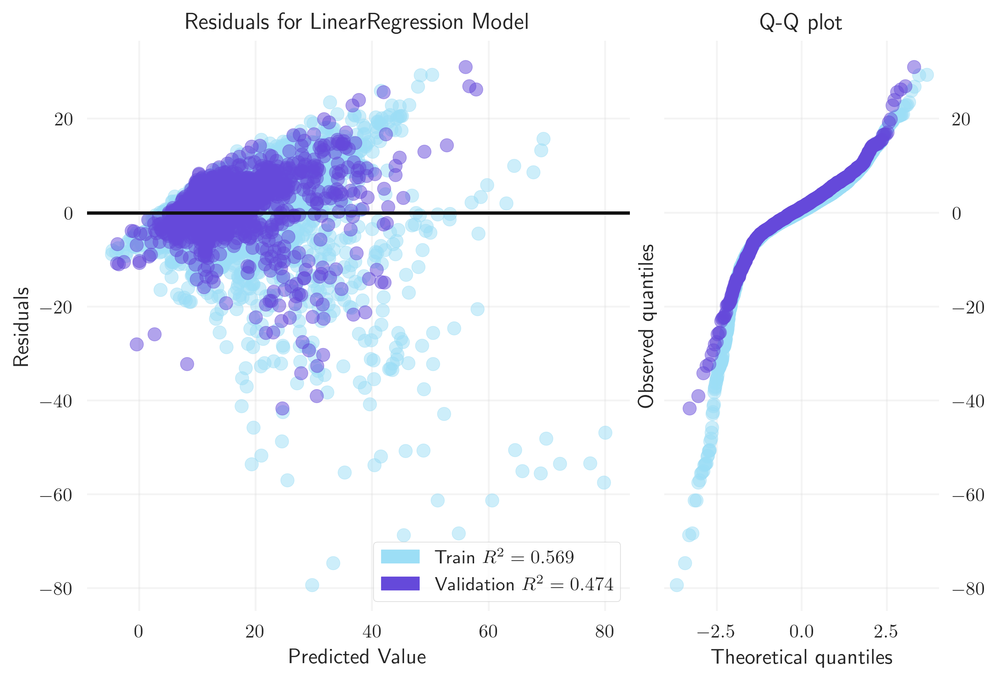

In [140]:
residuals_plot(poly_grid.best_estimator_, x, y, X_val, y_val)

## Bayesian Ridge

In [23]:
%%time

from sklearn.linear_model import BayesianRidge

bayesian_ridge = BayesianRidge()

bayesian_ridge_scores = cross_validate(bayesian_ridge, x, y, 
                            cv=stratified_kfold(x, y, 10), 
                            scoring=scoring)

bayesian_ridge.fit(x, y)

print_scores(bayesian_ridge_scores)

R2, MAE, RMSE
0.35, 4.98, 8.80


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


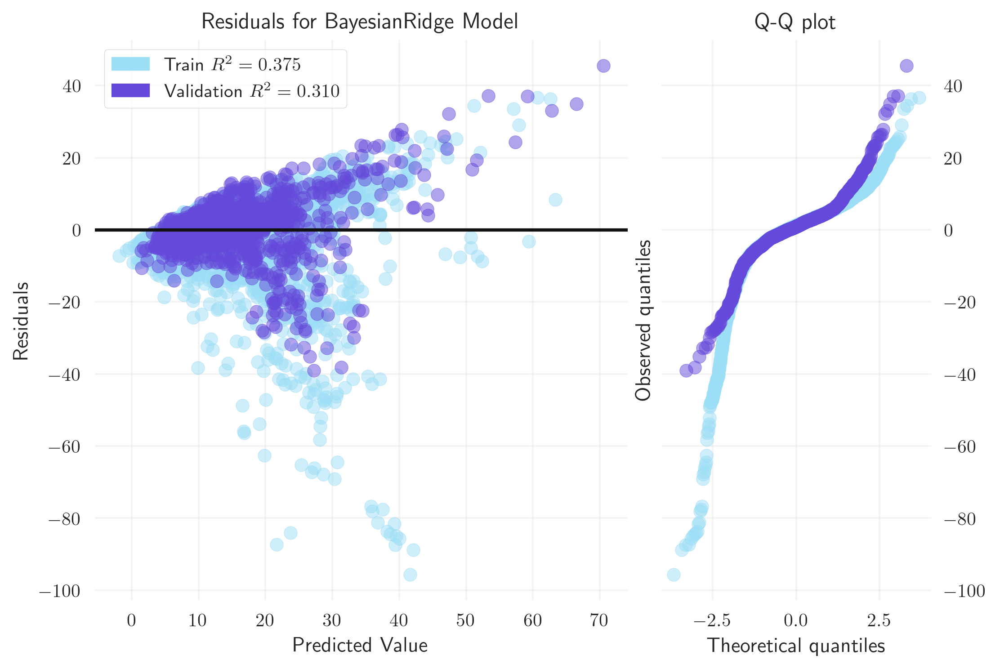

In [146]:
residuals_plot(bayesian_ridge, x, y, X_val, y_val)

## Support Vector Regression

In [117]:
%%time

from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

pipe = Pipeline([('scaler', StandardScaler()), ('svr', SVR())])

params={'svr__C': np.arange(5, 15.5, .5)}

svr_grid = GridSearchCV(pipe, params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

svr_grid.fit(x, y)

svr_scores = cross_validate(svr_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(x, y, 10), 
                                scoring=scoring)

print_scores(svr_scores)
print(svr_grid.best_params_)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.51, 3.93, 7.63
{'svr__C': 15.0}


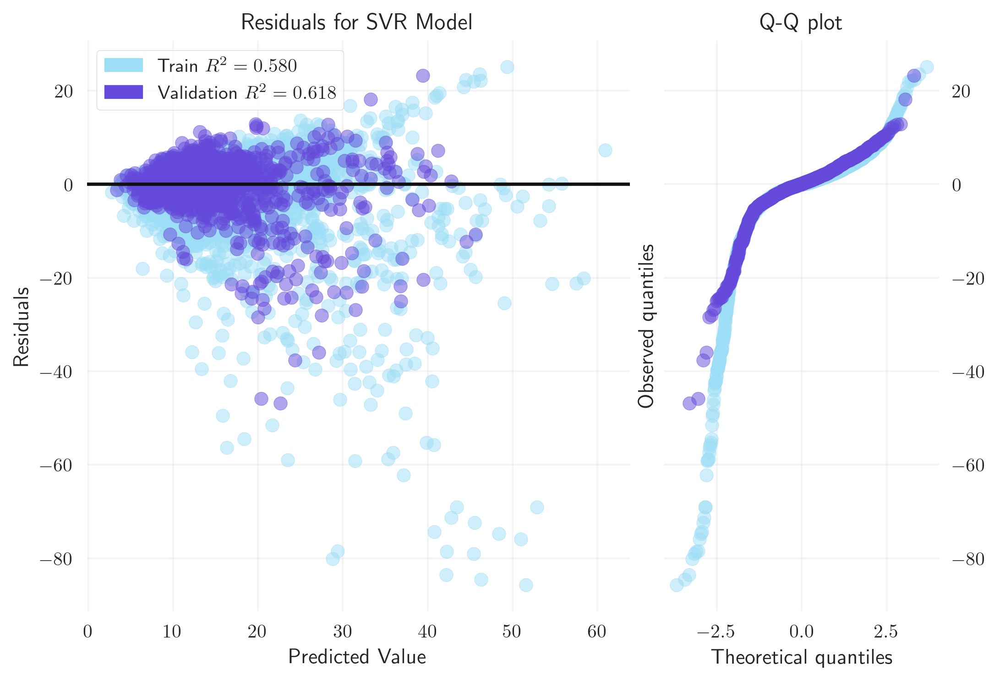

In [147]:
residuals_plot(svr_grid.best_estimator_, x, y, X_val, y_val)

## MARS

In [149]:
%%time

# https://github.com/scikit-learn-contrib/py-earth
from pyearth import Earth

mars = Earth()
    
mars_scores = cross_validate(mars, x, y, 
                                cv=stratified_kfold(x, y, 10), 
                                scoring=scoring)

mars.fit(x,y)

print_scores(mars_scores)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"
/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn_contrib_py_earth-0.1.0-py3.9-macosx-11-x86_64.egg/pyearth/earth.py:802: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  pruning_passer.run()
/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn_contrib_py_earth-0.1.0-py3.9-macosx-11-x86_64.egg/pyearth/earth.py:1055: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the i

R2, MAE, RMSE
0.41, 5.02, 8.32
CPU times: user 4min 32s, sys: 1min 1s, total: 5min 33s
Wall time: 42.6 s


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn_contrib_py_earth-0.1.0-py3.9-macosx-11-x86_64.egg/pyearth/earth.py:1055: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  coef, resid = np.linalg.lstsq(B, weighted_y[:, i])[0:2]


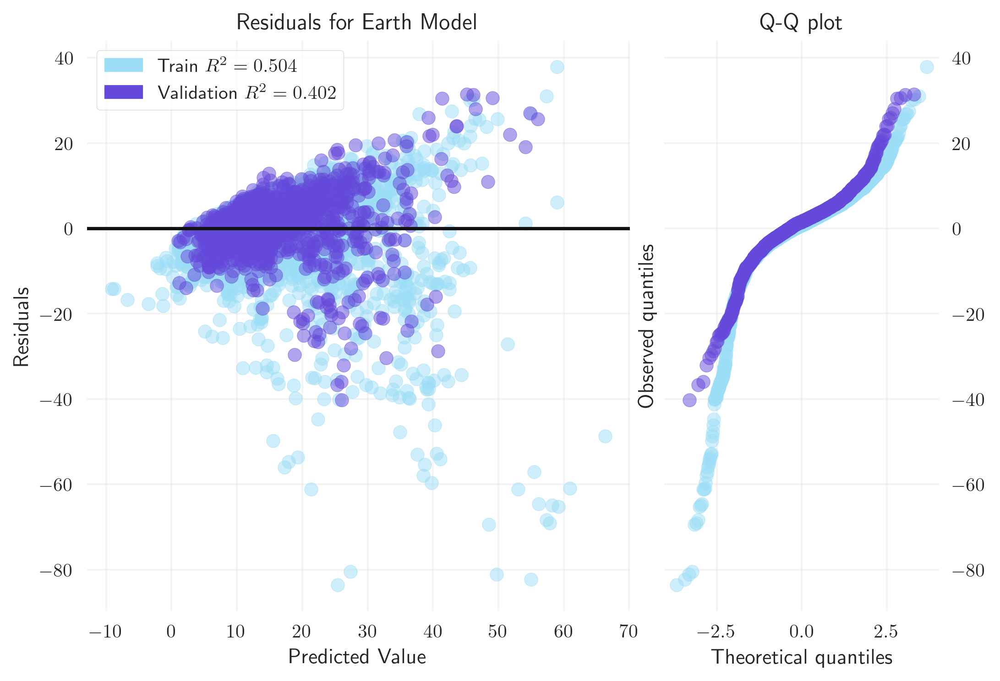

In [150]:
residuals_plot(mars, x, y, X_val, y_val)

## Mixed Effect

### Modeling

In [265]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(x)
data = x.copy(deep = True)
data.loc[:, data.columns] = scaler.transform(x)

data['PM'] = y
seasons = {1: 'Winter', 2 : 'Spring', 3 : 'Summer', 4 : 'Fall'}
data['Day of Month'] = data.index.day
data['Day of Year'] = data.index.day_of_year
data['Season'] = (data.index.month%12 // 3 + 1).map(seasons)
data['Season'] = data['Season'].astype(str)
data

,PS,QV2M,QV10M,T2M,T10M,TQI,TQV,AODANA,TS,Month,PM,Day of Month,Day of Year,Season
Date,,,,,,,,,,,,,,
2015-01-01,1.58,-1.64,-1.62,-2.08,-2.15,-0.23,0.12,-0.41,-2.02,-1.60,8.26,1,1,Winter
2015-01-01,1.12,-1.69,-1.67,-2.25,-2.32,-0.04,0.02,-0.46,-2.21,-1.60,7.70,1,1,Winter
2015-01-01,1.61,-1.67,-1.65,-2.17,-2.24,-0.16,0.04,-0.53,-2.09,-1.60,7.26,1,1,Winter
2015-01-01,1.89,-1.51,-1.50,-1.81,-1.89,-0.28,0.14,-0.45,-1.59,-1.60,8.72,1,1,Winter
2015-01-02,0.38,-1.35,-1.32,-1.73,-1.80,0.03,0.22,0.29,-1.66,-1.60,17.59,2,2,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-30,0.49,-1.46,-1.44,-1.77,-1.84,0.26,0.28,2.25,-1.68,1.59,17.48,30,364,Winter
2018-12-31,-0.25,-1.19,-1.18,-1.42,-1.47,-0.07,-0.14,0.24,-1.30,1.59,18.68,31,365,Winter
2018-12-31,-0.56,-1.34,-1.32,-1.64,-1.70,0.15,-0.31,0.35,-1.60,1.59,18.65,31,365,Winter


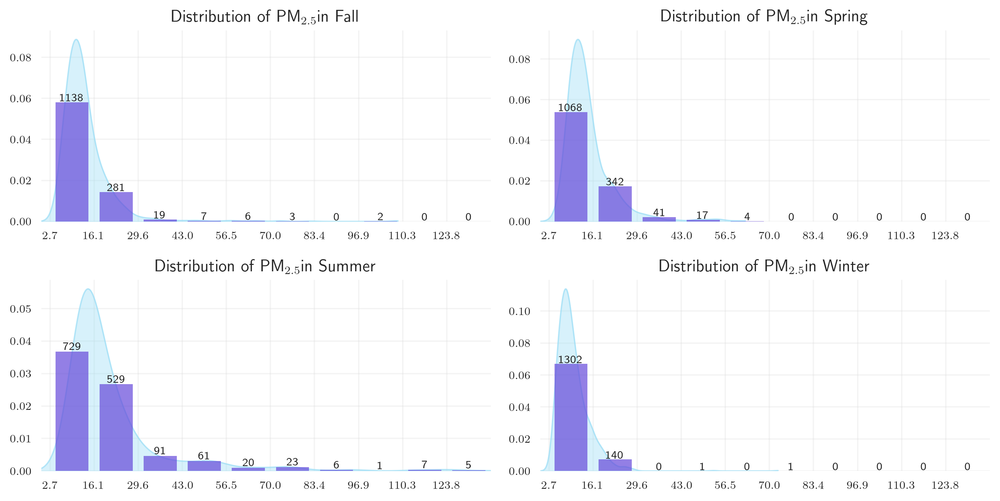

In [359]:
fig, axes = plt.subplots(2, 2, figsize=(10, 5.09), dpi=300)


# these bin values come from the cell in section 2
bins = [  2.6549096,  16.11584  ,  29.576773 ,  43.037704 ,  56.498634 , 69.959564 ,  83.420494 ,  96.881424 , 110.34236  , 123.80329  ,137.27422]
xlim = (0, data['PM'].max())

for (season, season_data), ax in zip(data.groupby('Season'), axes.ravel()):
    histogram_density_plot(season_data, 
                   by='PM', 
                   nbins=bins, 
                   title="Distribution of PM$_{2.5}$" + f"in {season}", 
                   tick_fontsize=8,
                   xmin=-2,
                   ax = ax,
                   xlim = xlim)
    
fig.tight_layout()

In [266]:
independents = x.columns.tolist()
independents.remove('Month')

independents = ' + '.join(independents)
dependent = 'PM'
formula = f'{dependent} ~ {independents}'
print(formula)

PM ~ PS + QV2M + QV10M + T2M + T10M + TQI + TQV + AODANA + TS


In [477]:
from statsmodels.api import MixedLM
from sklearn.base import BaseEstimator, RegressorMixin
from sklearn.model_selection import cross_validate

# https://stackoverflow.com/a/48949667/5217293
class MixedLMWrapper(BaseEstimator, RegressorMixin):
    """ A universal sklearn-style wrapper for statsmodels regressors """
    def __init__(self, formula, dependent_label, random_effect_variable, indepdendent_random_effect_formula):
        self.formula = formula
        self.dependent_label = dependent_label
        self.random_effect_variable = random_effect_variable
        self.indepdendent_random_effect_formula = indepdendent_random_effect_formula

    def fit(self, X, y):
        data = pd.concat([pd.DataFrame(X), pd.Series(y)], axis=1)
        data.columns = X.columns.tolist() + [self.dependent_label]
        self.model_ = MixedLM.from_formula(self.formula, 
                                           data= data, 
                                           groups=self.random_effect_variable,
                                           re_formula=self.indepdendent_random_effect_formula)
        self.results_ = self.model_.fit()
        
    def predict(self, X):
        return self.results_.predict(X)
    
    def summary(self):
        return self.results_.summary()

mixed_effect_day_of_month = MixedLMWrapper(formula, "PM", "Day of Month", "AODANA")
mixed_effect_month = MixedLMWrapper(formula, "PM", "Month", "AODANA")
mixed_effect_day_of_year = MixedLMWrapper(formula, "PM", "Day of Year", "AODANA")
mixed_effect_season = MixedLMWrapper(formula, "PM", "Season", "AODANA")

x_mixed = data.drop("PM", axis="columns")
y_mixed = data['PM']

mixed_models = [("Day of Month", mixed_effect_day_of_month), ("Month", mixed_effect_month), ("Day of Year", mixed_effect_day_of_year), ("Season", mixed_effect_season)]
mixed_scores = {}
for name, model in mixed_models:
    print(name)
    mixed_scores[name] = cross_validate(model, x_mixed, y_mixed, 
                                cv=stratified_kfold(x_mixed, y_mixed, 10), 
                                scoring=scoring)
    
    print_scores(mixed_scores[name])
    model.fit(x_mixed, y_mixed)
    display(model.summary())
    print()

Day of Month


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.33, 4.97, 8.86


<class 'statsmodels.iolib.summary2.Summary'>
"""
                 Mixed Linear Model Regression Results
=======================================================================
Model:                  MixedLM     Dependent Variable:     PM         
No. Observations:       5844        Method:                 REML       
No. Groups:             31          Scale:                  72.7686    
Min. group size:        112         Log-Likelihood:         -20857.6018
Max. group size:        192         Converged:              Yes        
Mean group size:        188.5                                          
-----------------------------------------------------------------------
                           Coef.  Std.Err.    z    P>|z|  [0.025 0.975]
-----------------------------------------------------------------------
Intercept                  14.936    0.181  82.397 0.000  14.581 15.292
PS                          1.432    0.148   9.651 0.000   1.141  1.723
QV2M                       17.184    3.911   4.394 0.000   9.518 24.849
QV10M                     -16.383    3.761  -4.356 0.000 -23.754 -9.012
T2M                       -19.264    6.621  -2.910 0.004 -32.240 -6.287
T10M                       18.096    4.668   3.876 0.000   8.946 27.246
TQI                         1.637    0.155  10.580 0.000   1.334  1.940
TQV                        -2.744    0.268 -10.219 0.000  -3.270 -2.217
AODANA                      5.969    0.380  15.687 0.000   5.223  6.714
TS                          4.184    2.260   1.851 0.064  -0.246  8.614
Day of Month Var            0.625    0.031                             
Day of Month x AODANA Cov   1.251    0.052                             
AODANA Var                  3.844    0.131                             
=======================================================================

"""


Month


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.21, 6.07, 9.67


<class 'statsmodels.iolib.summary2.Summary'>
"""
             Mixed Linear Model Regression Results
================================================================
Model:               MixedLM   Dependent Variable:   PM         
No. Observations:    5844      Method:               REML       
No. Groups:          12        Scale:                51.5023    
Min. group size:     452       Log-Likelihood:       -19855.7051
Max. group size:     496       Converged:            Yes        
Mean group size:     487.0                                      
----------------------------------------------------------------
                    Coef.  Std.Err.    z    P>|z|  [0.025 0.975]
----------------------------------------------------------------
Intercept           14.874    1.441  10.323 0.000  12.049 17.698
PS                   0.592    0.128   4.639 0.000   0.342  0.841
QV2M               -15.694    3.844  -4.083 0.000 -23.229 -8.160
QV10M               17.408    3.719   4.681 0.000  10.119 24.697
T2M                -10.219    5.668  -1.803 0.071 -21.327  0.889
T10M                11.945    4.042   2.955 0.003   4.023 19.867
TQI                  1.311    0.139   9.409 0.000   1.038  1.584
TQV                 -4.614    0.250 -18.443 0.000  -5.104 -4.123
AODANA               8.209    1.260   6.514 0.000   5.739 10.679
TS                  -2.352    1.939  -1.213 0.225  -6.152  1.448
Month Var           24.757    1.508                             
Month x AODANA Cov  17.588    1.180                             
AODANA Var          18.797    1.130                             
================================================================

"""


Day of Year


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.28, 5.38, 9.24


<class 'statsmodels.iolib.summary2.Summary'>
"""
                Mixed Linear Model Regression Results
======================================================================
Model:                 MixedLM     Dependent Variable:     PM         
No. Observations:      5844        Method:                 REML       
No. Groups:            366         Scale:                  23.7412    
Min. group size:       4           Log-Likelihood:         -18448.6987
Max. group size:       16          Converged:              Yes        
Mean group size:       16.0                                           
----------------------------------------------------------------------
                          Coef.  Std.Err.    z    P>|z|  [0.025 0.975]
----------------------------------------------------------------------
Intercept                 14.913    0.293  50.935 0.000  14.340 15.487
PS                         0.477    0.105   4.552 0.000   0.272  0.682
QV2M                      -6.030    2.971  -2.030 0.042 -11.852 -0.208
QV10M                      7.247    2.880   2.516 0.012   1.602 12.893
T2M                      -14.082    4.454  -3.162 0.002 -22.812 -5.353
T10M                      13.623    3.234   4.213 0.000   7.286 19.961
TQI                        1.332    0.121  11.008 0.000   1.095  1.570
TQV                       -3.520    0.215 -16.399 0.000  -3.941 -3.099
AODANA                     7.554    0.401  18.842 0.000   6.768  8.339
TS                         0.643    1.484   0.434 0.665  -2.266  3.552
Day of Year Var           27.548    0.530                             
Day of Year x AODANA Cov  25.341    0.559                             
AODANA Var                49.749    0.894                             
======================================================================

"""


Season


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.29, 5.29, 9.16


<class 'statsmodels.iolib.summary2.Summary'>
"""
             Mixed Linear Model Regression Results
================================================================
Model:               MixedLM   Dependent Variable:   PM         
No. Observations:    5844      Method:               REML       
No. Groups:          4         Scale:                56.4949    
Min. group size:     1444      Log-Likelihood:       -20091.6043
Max. group size:     1472      Converged:            Yes        
Mean group size:     1461.0                                     
----------------------------------------------------------------
                    Coef.  Std.Err.    z    P>|z|  [0.025 0.975]
----------------------------------------------------------------
Intercept           14.565    1.758   8.286 0.000  11.120 18.010
PS                   0.772    0.131   5.910 0.000   0.516  1.028
QV2M                -3.355    3.640  -0.922 0.357 -10.489  3.779
QV10M                5.341    3.522   1.517 0.129  -1.561 12.244
T2M                 -2.330    5.893  -0.395 0.693 -13.880  9.221
T10M                 4.952    4.197   1.180 0.238  -3.274 13.177
TQI                  1.533    0.140  10.968 0.000   1.259  1.807
TQV                 -4.515    0.255 -17.676 0.000  -5.016 -4.014
AODANA               7.673    2.203   3.484 0.000   3.356 11.990
TS                  -2.010    1.988  -1.011 0.312  -5.907  1.886
Season Var          12.308    1.351                             
Season x AODANA Cov 13.000    1.552                             
AODANA Var          19.328    2.103                             
================================================================

"""

### Plots

In [478]:
mixed_effect_season.results_.random_effects

{'Fall': Season    1.93
 AODANA   -1.17
 dtype: float64,
 'Spring': Season   -3.13
 AODANA   -3.25
 dtype: float64,
 'Summer': Season   3.95
 AODANA   6.46
 dtype: float64,
 'Winter': Season   -2.74
 AODANA   -2.04
 dtype: float64}

<BarContainer object of 4 artists>


Text(0.5, 1.0, 'Intercepts per season')

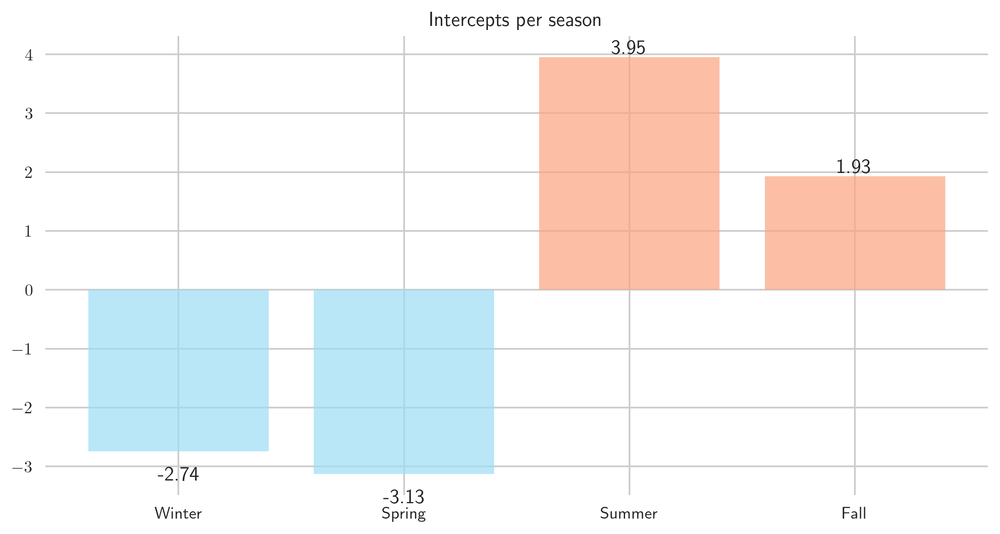

In [479]:
fig, ax = plt.subplots(figsize=(10, 5), dpi=300)

random_effects = [mixed_effect_season.results_.random_effects[i].values[0] for i in seasons.values()]
colors = ["#FCA481" if i >= 0 else "#9CDEF6" for i in random_effects]

bars = ax.bar(seasons.values(), random_effects, alpha=0.7, color=colors, zorder=3)
print(bars)
for bar in bars:
    _x = bar.get_x() + bar.get_width() / 2
    offset = 0.05 if bar.get_height() > 0 else -.5
    _y = bar.get_y() + bar.get_height() + offset
    ax.text(_x, _y, f'{bar.get_height():.02f}', ha='center')

ax.set_title("Intercepts per season")

In [480]:
season_days = data[["Day of Year", "Season"]].loc["2016"]
season_days = season_days[~season_days.index.duplicated(keep='first')]
season_days

,Day of Year,Season
Date,,
2016-01-01,1,Winter
2016-01-02,2,Winter
2016-01-03,3,Winter
2016-01-04,4,Winter
2016-01-05,5,Winter
...,...,...
2016-12-27,362,Winter
2016-12-28,363,Winter
2016-12-29,364,Winter


In [481]:
season_days[season_days["Season"] == 'Winter']

,Day of Year,Season
Date,,
2016-01-01,1,Winter
2016-01-02,2,Winter
2016-01-03,3,Winter
2016-01-04,4,Winter
2016-01-05,5,Winter
...,...,...
2016-12-27,362,Winter
2016-12-28,363,Winter
2016-12-29,364,Winter


In [507]:
intercepts = pd.DataFrame(mixed_effect_day_of_year.results_.random_effects).T
intercepts

,Day of Year,AODANA
1,-3.79,-3.44
2,-3.61,-0.56
3,-3.43,-1.47
4,1.66,1.65
5,0.21,-0.51
...,...,...
362,-3.64,-3.08
363,-5.77,-5.19
364,-4.49,-2.79
365,-2.37,0.52


In [510]:
summer_avg = intercepts.iloc[153:245].mean()
fall_avg = intercepts.iloc[245:335].mean()
spring_avg = intercepts.iloc[61:152].mean()
winter_avg = pd.concat([intercepts.iloc[1:61], intercepts.iloc[336:]]).mean()

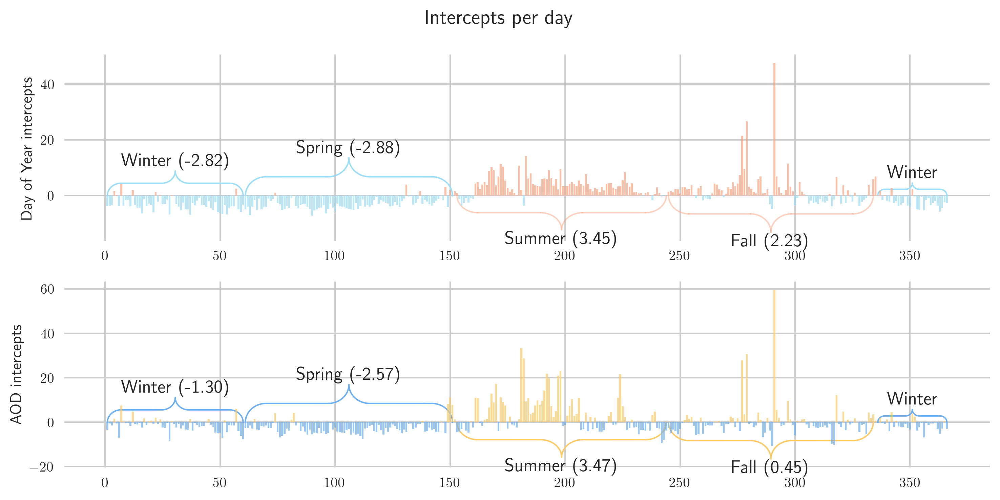

In [524]:
import sys
try:
    sys.path.index('matplotlib-curly-brace')
except:
    sys.path.append('matplotlib-curly-brace')

# https://matplotlib-curly-brace.readthedocs.io/en/latest/index.html
from curlyBrace import curlyBrace

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 5), dpi=300)

doy_random_effects = np.array([mixed_effect_day_of_year.results_.random_effects[i].values[0] for i in range(1, 367)])
aod_random_effects = np.array([mixed_effect_day_of_year.results_.random_effects[i].values[1] for i in range(1, 367)])


doy_colors = ["#FCA481" if slope >= 0 else "#9CDEF6" for slope in doy_random_effects]
aod_colors = ["#FDCB66" if slope >= 0 else "#6CB0F2" for slope in aod_random_effects]

x = np.arange(1, 367)

ax1.bar(x, doy_random_effects, alpha=0.7, color=doy_colors, zorder=3)
ax2.bar(x, aod_random_effects, alpha=0.7, color=aod_colors, zorder=3)

ax1.set_ylabel("Day of Year intercepts")
ax2.set_ylabel("AOD intercepts")

summer_start = [153, 0]
summer_end = [244, 0]

fall_start = [245, 0]
fall_end = [334, 0]

spring_start = [61, 0]
spring_end = [151, 0]

winter1_start = [1, 0]
winter1_end = [60, 0]

winter2_start = [336, 0]
winter2_end = [366, 0]

font = {'size': 13}

warm_colors = ['#FCA48180', "#FDCB66"]
cool_colors = ["#9CDEF6", "#6CB0F2"]

for idx, ax in enumerate([ax1, ax2]):
    warm = warm_colors[idx]
    cool = cool_colors[idx]
    curlyBrace(fig, ax, summer_end, summer_start, 
               0.1, bool_auto=True, 
               str_text=f"Summer ({summer_avg.values[idx]:.2f})", color=warm, lw=1, int_line_num=1, fontdict=font);

    curlyBrace(fig, ax, fall_end, fall_start,
               0.1, bool_auto=True, 
               str_text=f"Fall ({fall_avg.values[idx]:.2f})", color=warm, lw=1, int_line_num=1, fontdict=font);

    curlyBrace(fig, ax, spring_start, spring_end, 
               0.1, bool_auto=True, 
               str_text=f"Spring ({spring_avg.values[idx]:.2f})", color=cool, lw=1, int_line_num=1, fontdict=font);

    curlyBrace(fig, ax, winter1_start, winter1_end, 
               0.1, bool_auto=True, 
               str_text=f"Winter ({winter_avg.values[idx]:.2f})", color=cool, lw=1, int_line_num=1, fontdict=font);

    curlyBrace(fig, ax, winter2_start, winter2_end, 
               0.1, bool_auto=True, 
               str_text="Winter", color=cool, lw=1, int_line_num=1, fontdict=font);

fig.suptitle("Intercepts per day");
fig.tight_layout()

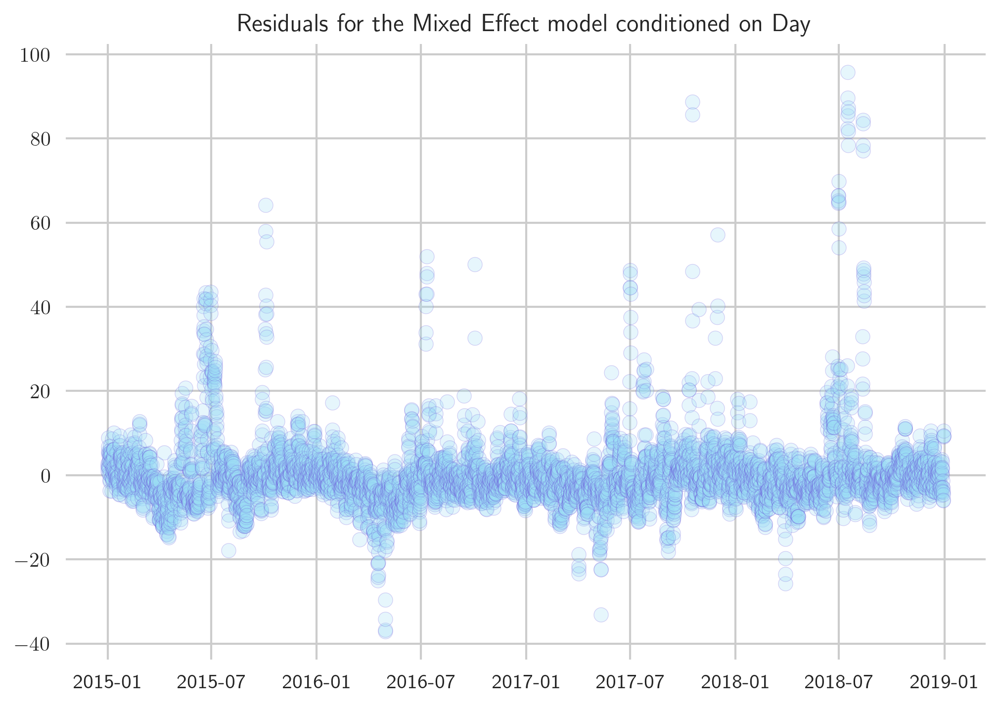

In [270]:
plot_residuals(mixed_effect_day_of_month, "Residuals for the Mixed Effect model conditioned on Day")

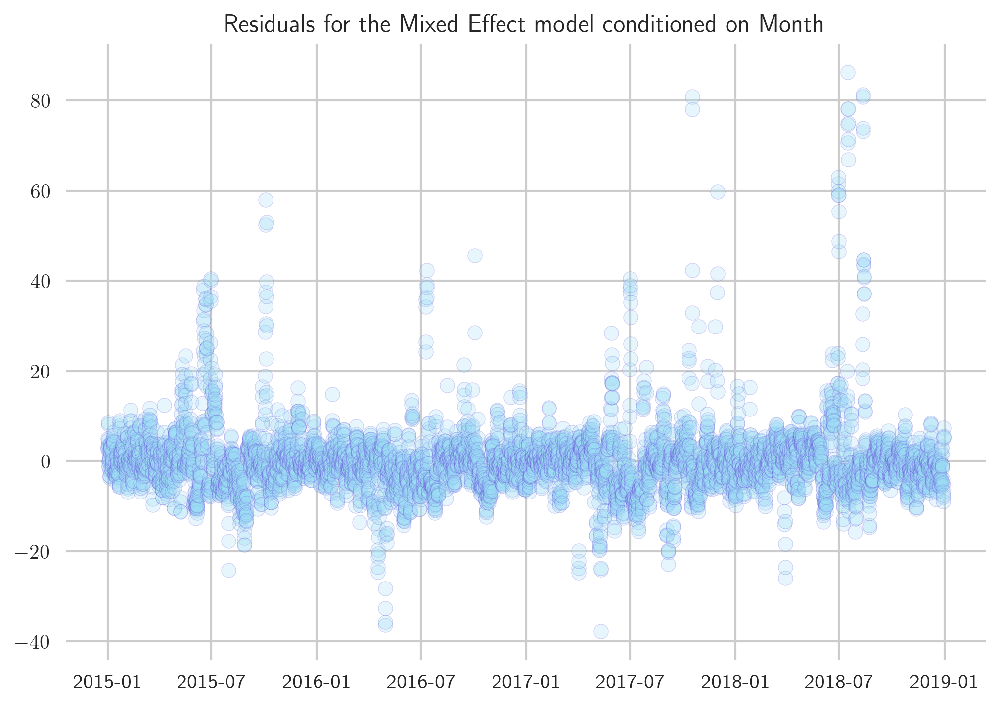

In [271]:
plot_residuals(mixed_effect_month, "Residuals for the Mixed Effect model conditioned on Month")

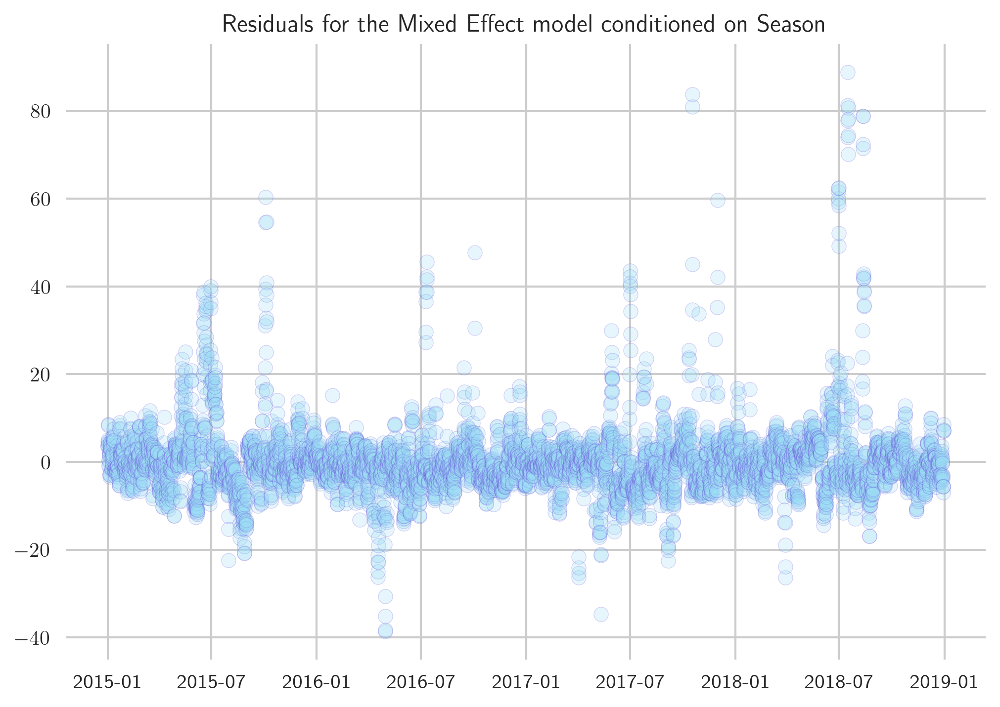

In [272]:
plot_residuals(mixed_effect_season, "Residuals for the Mixed Effect model conditioned on Season")

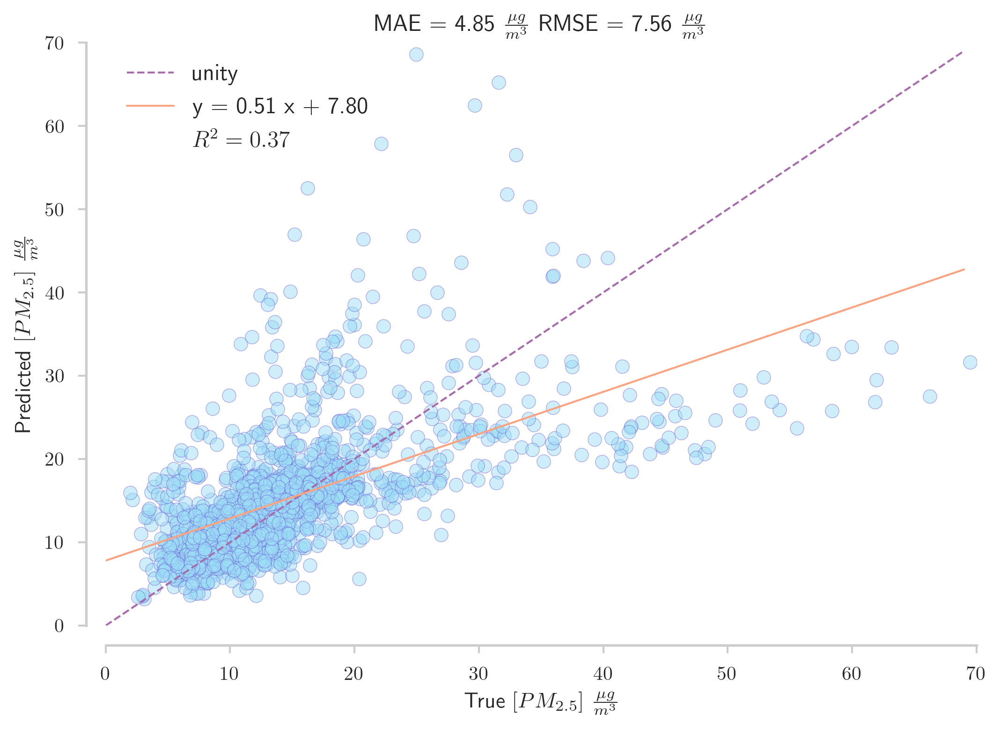

In [525]:
_x_val = X_val.copy()
_x_val.loc[:, _x_val.columns] = scaler.transform(_x_val)

plot_prediction_error(mixed_effect_day_of_month, _x_val, y_val, r2_ax_locx = .1, dropped_spines = True)

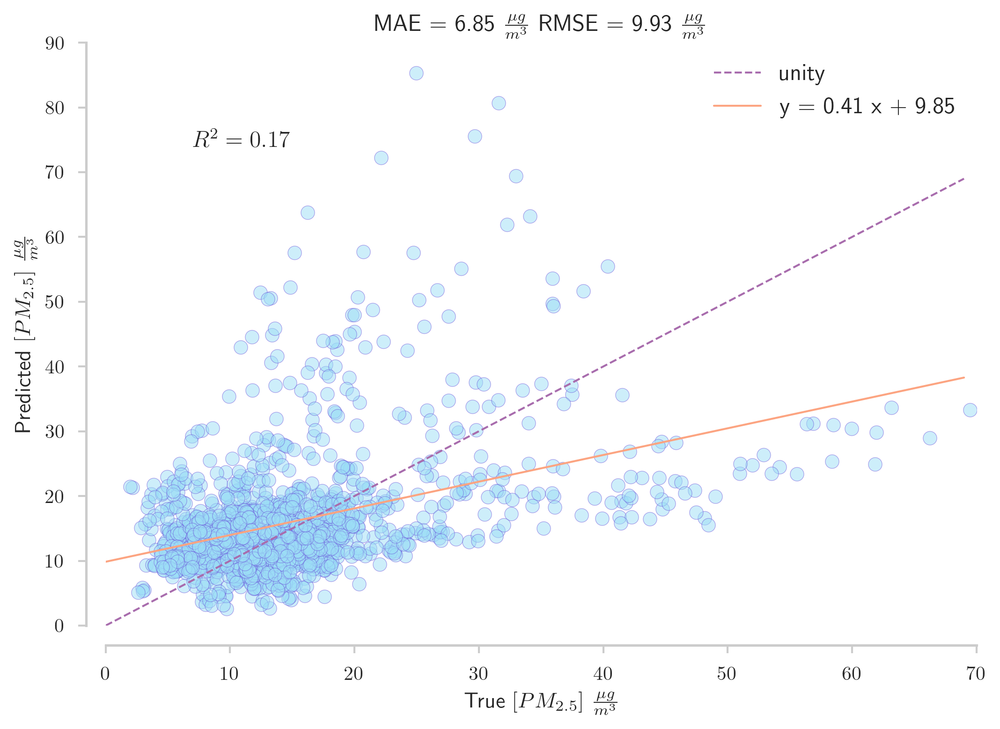

In [526]:
plot_prediction_error(mixed_effect_month, _x_val, y_val, r2_ax_locx = .1, dropped_spines = True)

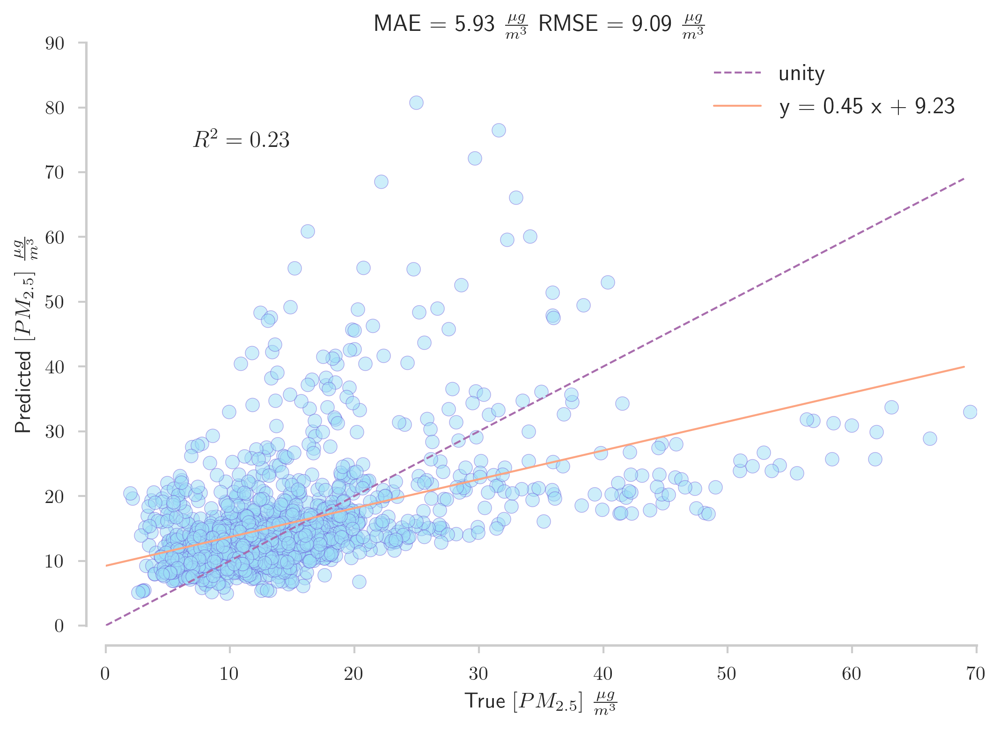

In [527]:
plot_prediction_error(mixed_effect_day_of_year, _x_val, y_val, r2_ax_locx = .1, dropped_spines = True)

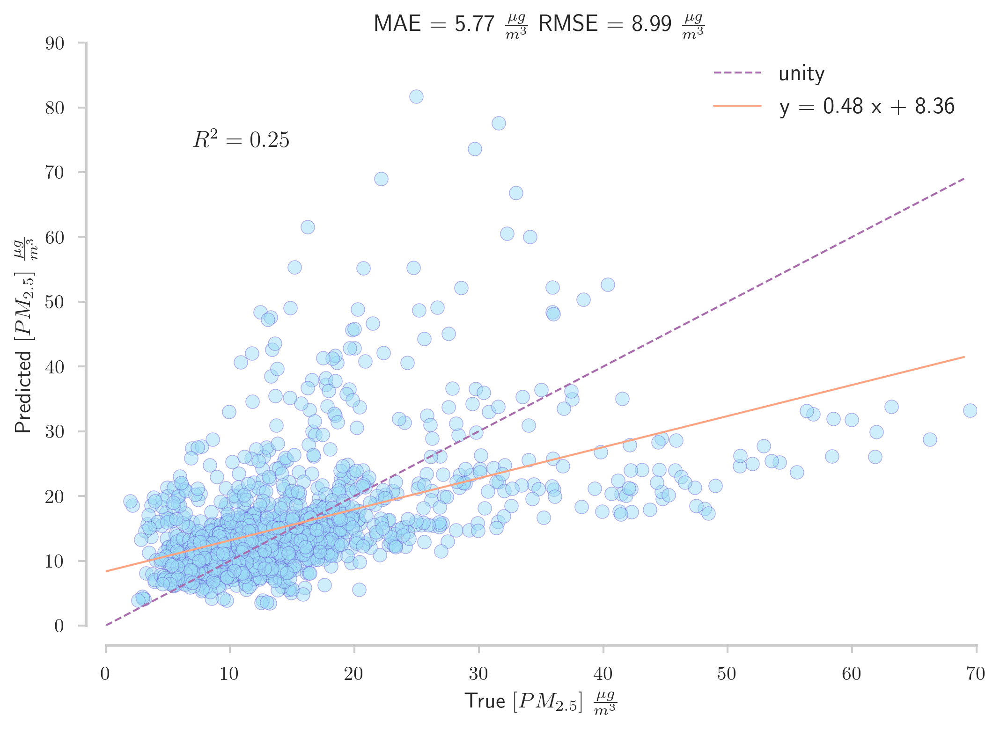

In [528]:
plot_prediction_error(mixed_effect_season, _x_val, y_val, r2_ax_locx = .1, dropped_spines = True)

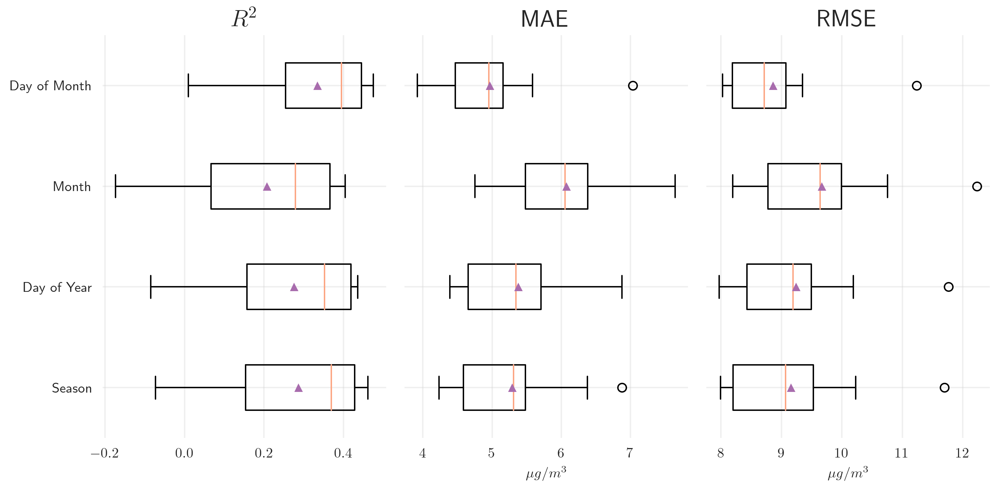

In [529]:
_r2s = []
_maes = []
_rmses = []
_ls = []

for name, _scores in mixed_scores.items():
    _r2s.append(_scores['test_r2'])
    _maes.append(np.abs(_scores['test_neg_mean_absolute_error']))
    _rmses.append(np.abs(_scores['test_neg_root_mean_squared_error']))
    _ls.append(name)
    
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(10, 5), dpi=300)

boxes = []
boxes.append(ax1.boxplot(_r2s, labels=_ls, vert=False, showmeans=True))
boxes.append(ax2.boxplot(_maes, labels=[''] * 4, vert=False, showmeans=True))
boxes.append(ax3.boxplot(_rmses, labels=[''] * 4, vert=False, showmeans=True))

for box in boxes:
    for mean in box['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in box['medians']:
        median.set_color('#FCA481')

ax1.set_title('$R^2$', fontsize=17)
ax2.set_title('MAE', fontsize=17)
ax3.set_title('RMSE', fontsize=17)

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()

ax2.set_xlabel(r'$\mu g/m^3$', fontsize=10)
ax3.set_xlabel(r'$\mu g/m^3$', fontsize=10)

for ax in [ax1, ax2, ax3]:
    ax.tick_params(axis='both', labelsize=10, width=0, which='both')
    ax.grid(True, alpha=0.3)

fig.tight_layout()

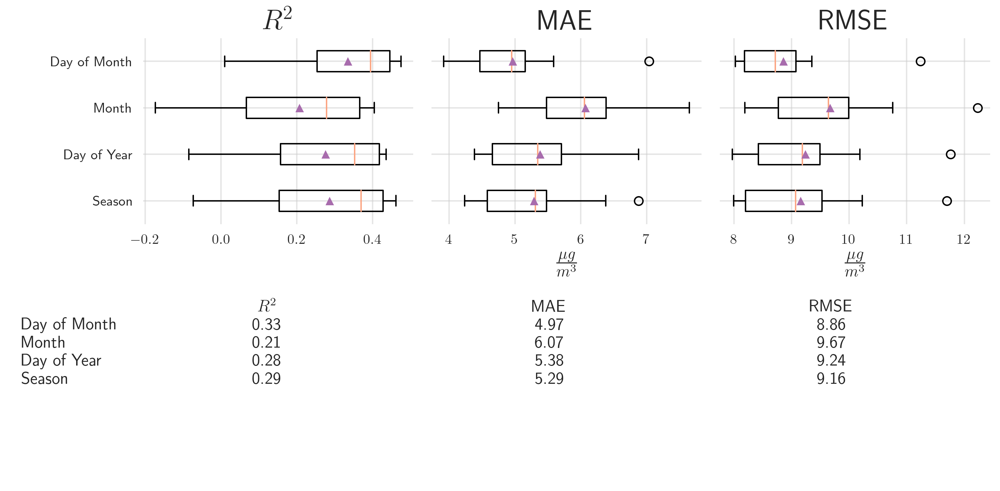

In [530]:
_labels, _scores = map(list, zip(*mixed_scores.items()))

grouped_boxplot_with_table(_scores, _labels)

## GAM (not used)

In [53]:
from statsmodels.gam.api import GLMGam, BSplines

from sklearn.base import BaseEstimator, RegressorMixin
from sklearn.model_selection import cross_validate

# https://stackoverflow.com/a/48949667/5217293
class GLMGamWrapper(BaseEstimator, RegressorMixin):
    """ A universal sklearn-style wrapper for statsmodels regressors """
    def __init__(self, formula, dependent_label, df, degree, alpha):
        self.formula = formula
        self.dependent_label = dependent_label
        self.df = df
        self.degree = degree
        self.alpha = alpha

    def fit(self, X, y):
        data = pd.concat([pd.DataFrame(X), pd.Series(y)], axis=1)
        data.columns = X.columns.tolist() + [self.dependent_label]
        
        self.bs = BSplines(X, df=self.df, degree=self.degree)

        
        self.model_ = GLMGam.from_formula(self.formula,
                                          data=data,
                                          smoother = self.bs,
                                          alpha=self.alpha)
        self.results_ = self.model_.fit()
        
    def predict(self, X):
        return self.results_.predict(X)
    
    def summary(self):
        return self.results_.summary()

x_gam = x_mixed.drop(["Day of Month", "Day of Year", "Season"], axis="columns") 
    
gam = GLMGamWrapper(formula, "PM", 
                    df = [4] * x_gam.columns.size, 
                    degree = [3] * x_gam.columns.size,
                    alpha = [1] * x_gam.columns.size)

# gam_scores = cross_validate(gam, x_gam, y, 
#                             cv=10, #stratified_kfold(y, 10), 
#                             scoring=scoring)

# print_scores(gam_scores)
gam.fit(x_gam, y)
display(gam.summary())

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_validation.py:683: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 56, in _cached_call
    return cache[method]
KeyError: 'predict'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_validation.py", line 674, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/metrics/_scorer.py", line 87, in __call__
    score = scorer._score(cached_call, estimator,
  File "/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/skl

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                     PM   No. Observations:                 5844
Model:                         GLMGam   Df Residuals:                  5818.12
Model Family:                Gaussian   Df Model:                        24.88
Link Function:               identity   Scale:                          65.402
Method:                         PIRLS   Log-Likelihood:                -20495.
Date:                Wed, 19 May 2021   Deviance:                   3.8052e+05
Time:                        14:16:01   Pearson chi2:                 3.81e+05
No. Iterations:                     3                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      2.9827      0.411      7.260      0.000       2.177       3.788
PS             0.2260      0.359      0.630      0.529      -0.477       0.929
QV2M         -13.9144      5.119     -2.718      0.007     -23.947      -3.882
QV10M         15.1279      4.785      3.162      0.002       5.750      24.506
T2M           -8.5036      6.739     -1.262      0.207     -21.711       4.704
T10M          13.3936      4.952      2.705      0.007       3.688      23.099
TQI           -0.2023      0.304     -0.666      0.505      -0.798       0.393
TQV           -4.7343      0.382    -12.409      0.000      -5.482      -3.987
AODANA         5.0800      0.218     23.326      0.000       4.653       5.507
TS            -3.8020      2.395     -1.588      0.112      -8.496       0.892
PS_s0         -2.9886      3.097     -0.965      0.335      -9.059       3.082
PS_s1          8.4678      3.104      2.728      0.006       2.384      14.552
PS_s2         -3.3362      1.540     -2.166      0.030      -6.355      -0.317
QV2M_s0       14.4588      6.274      2.304      0.021       2.161      26.756
QV2M_s1       -0.8786      4.540     -0.194      0.847      -9.776       8.019
QV2M_s2       -5.8226      3.487     -1.670      0.095     -12.658       1.013
QV10M_s0      -1.8651      5.879     -0.317      0.751     -13.388       9.658
QV10M_s1     -15.9502      4.451     -3.584      0.000     -24.674      -7.226
QV10M_s2      16.4728      3.388      4.862      0.000       9.832      23.113
T2M_s0        -3.4248      8.729     -0.392      0.695     -20.533      13.683
T2M_s1       -18.1631      6.360     -2.856      0.004     -30.629      -5.698
T2M_s2        13.6361      5.226      2.609      0.009       3.392      23.880
T10M_s0        6.8880      7.687      0.896      0.370      -8.179      21.955
T10M_s1        1.2160      5.506      0.221      0.825      -9.576      12.008
T10M_s2        1.6201      4.314      0.376      0.707      -6.835      10.076
TQI_s0        -5.6668      1.691     -3.352      0.001      -8.980      -2.353
TQI_s1        33.2760      4.480      7.427      0.000      24.495      42.057
TQI_s2       -20.1119      2.964     -6.785      0.000     -25.921     -14.302
TQV_s0        -2.0247      1.915     -1.057      0.290      -5.779       1.729
TQV_s1         0.5158      1.848      0.279      0.780      -3.106       4.137
TQV_s2         0.6212      0.965      0.644      0.520      -1.270       2.512
AODANA_s0      9.0386      2.001      4.517      0.000       5.117      12.960
AODANA_s1     29.9998      3.588      8.362      0.000      22.968      37.032
AODANA_s2    -21.9821      2.111    -10.415      0.000     -26.119     -17.846
TS_s0          1.8188      6.688      0.272      0.786     -11.289      14.927
TS_s1         11.8438      4.251      2.786      0.005       3.512      20.176
TS

In [ ]:
gam.model_.select_penweight_kfold()[0]

# Neural Networks

## Multi-layer Perceptron

In [126]:
%%time
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

params={
    'mlp__hidden_layer_sizes': [[10, 10, 10], [10, 20, 10], [10, 20, 20], [10, 10, 10, 10, 10]],
    'mlp__beta_1': np.arange(0.1, 1, .1),
    'mlp__beta_2': np.arange(.9, .99, .01)
}

mlp_pipe = Pipeline([('scaler', StandardScaler()), ('mlp', MLPRegressor(
    max_iter=2000, 
    early_stopping=True))])

mlp_grid = GridSearchCV(mlp_pipe, params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

mlp_grid.fit(x, y)

mlp_scores = cross_validate(mlp_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

print_scores(mlp_scores)

print(mlp_grid.best_params_)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.53, 4.30, 7.37
{'mlp__beta_1': 0.6, 'mlp__beta_2': 0.9, 'mlp__hidden_layer_sizes': [10, 10, 10, 10, 10]}


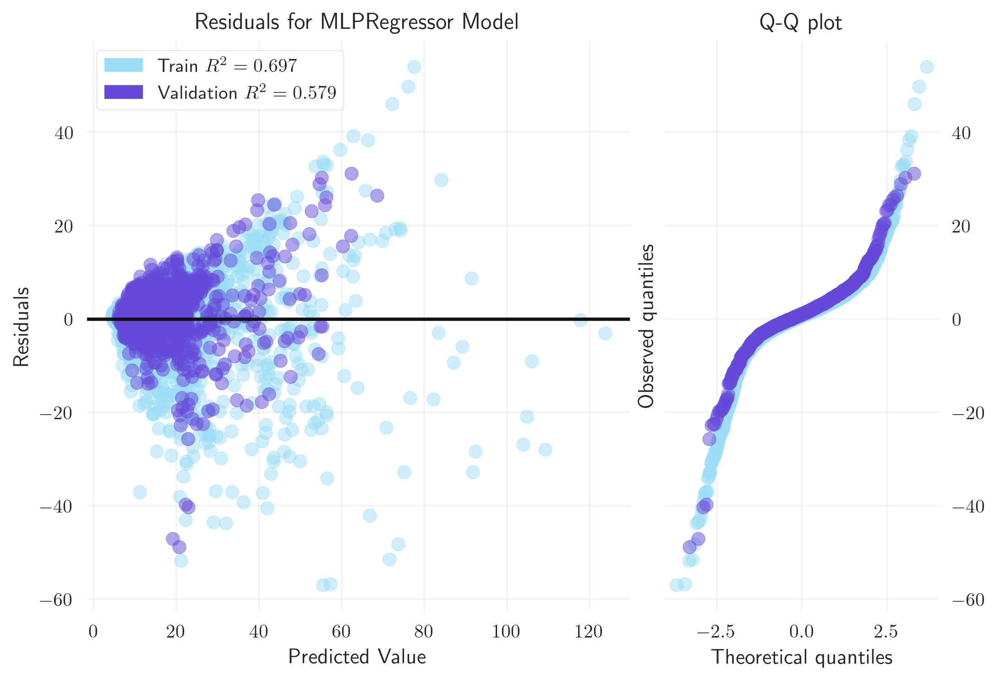

In [127]:
residuals_plot(mlp_grid.best_estimator_, x, y, X_val, y_val)

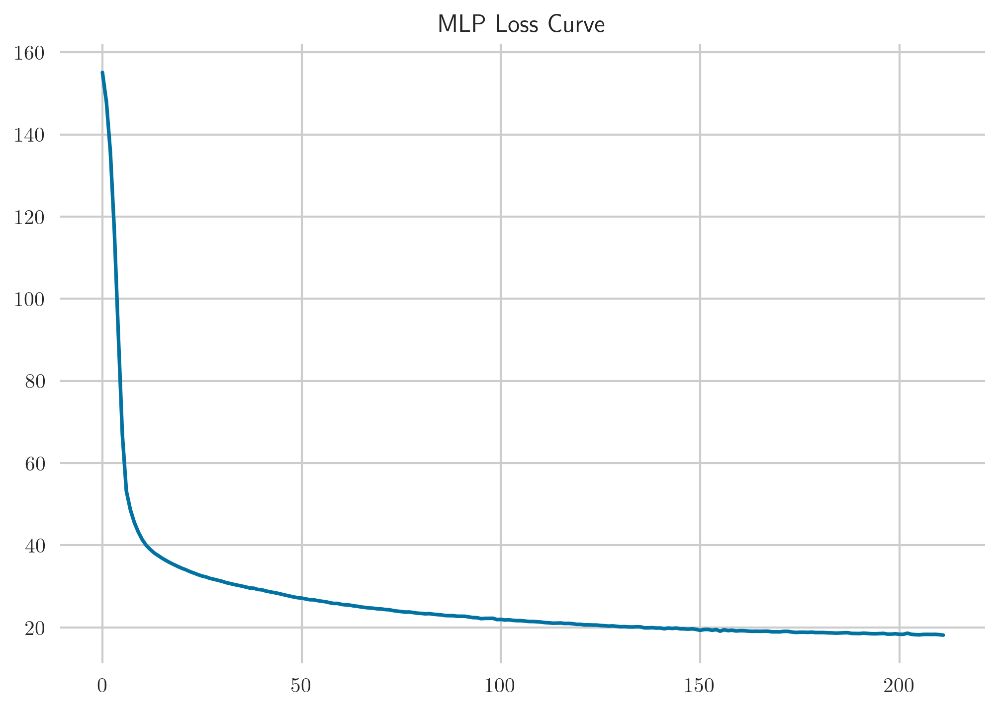

In [154]:
fig, ax = plt.subplots(dpi=300)

ax.plot(mlp_grid.best_estimator_.named_steps['mlp'].loss_curve_)

ax.set_title('MLP Loss Curve');

# Trees

## AdaBoost

In [35]:
%%time
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor

params={
    'base_estimator': [DecisionTreeRegressor(max_depth=3), DecisionTreeRegressor(max_depth=4), DecisionTreeRegressor(max_depth=5)],
    'learning_rate': np.arange(0.5, 2, .1),
    'loss': ['linear', 'square', 'exponential'],
    'n_estimators': np.arange(10, 100, 10)
}

ada_grid = GridSearchCV(AdaBoostRegressor(), params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

ada_grid.fit(x, y)

ada_scores = cross_validate(ada_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

print_scores(ada_scores)

print(ada_grid.best_params_)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.56, 4.67, 7.13
{'base_estimator': DecisionTreeRegressor(max_depth=5), 'learning_rate': 1.4999999999999998, 'loss': 'exponential', 'n_estimators': 10}


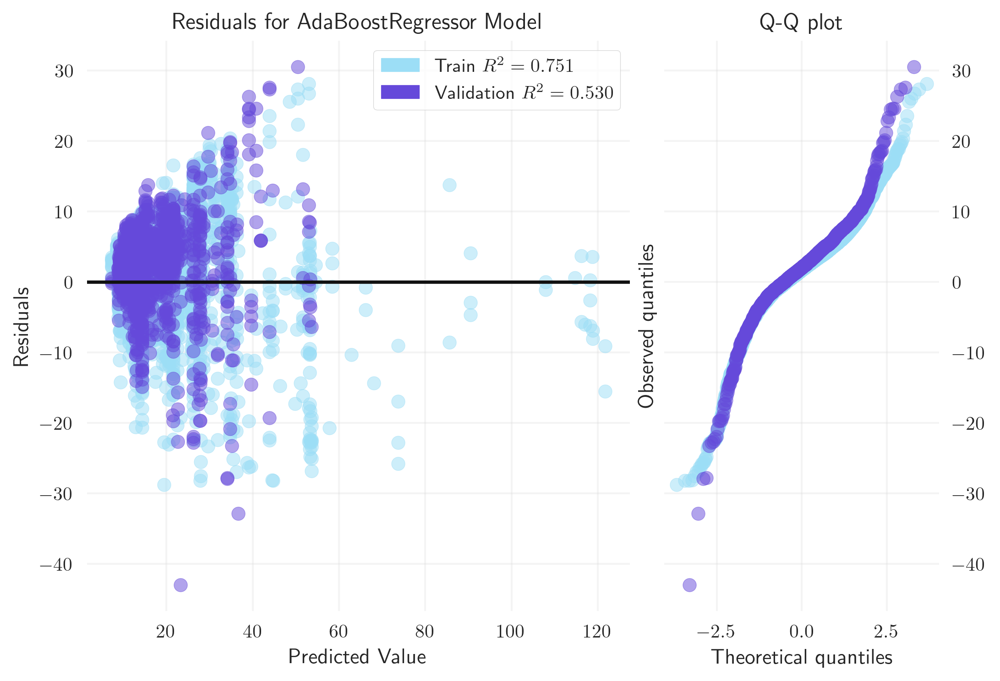

In [106]:
residuals_plot(ada_grid.best_estimator_, x, y, X_val, y_val)

## Random Forest

In [38]:
%%time
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor

params={
    'n_estimators': np.arange(10, 100, 10),
    'min_samples_split': [2, 3, 4],
    'min_samples_leaf': [1, 2, 3],
    'max_features': ['auto', 'sqrt', 'log2'],
    'ccp_alpha': np.arange(0, 1.1, 0.2)
}

rf_grid = GridSearchCV(RandomForestRegressor(n_jobs=-1), params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

rf_grid.fit(x, y)

rf_scores = cross_validate(rf_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

print_scores(rf_scores)

print(rf_grid.best_params_)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.63, 4.01, 6.54
{'ccp_alpha': 0.0, 'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 70}


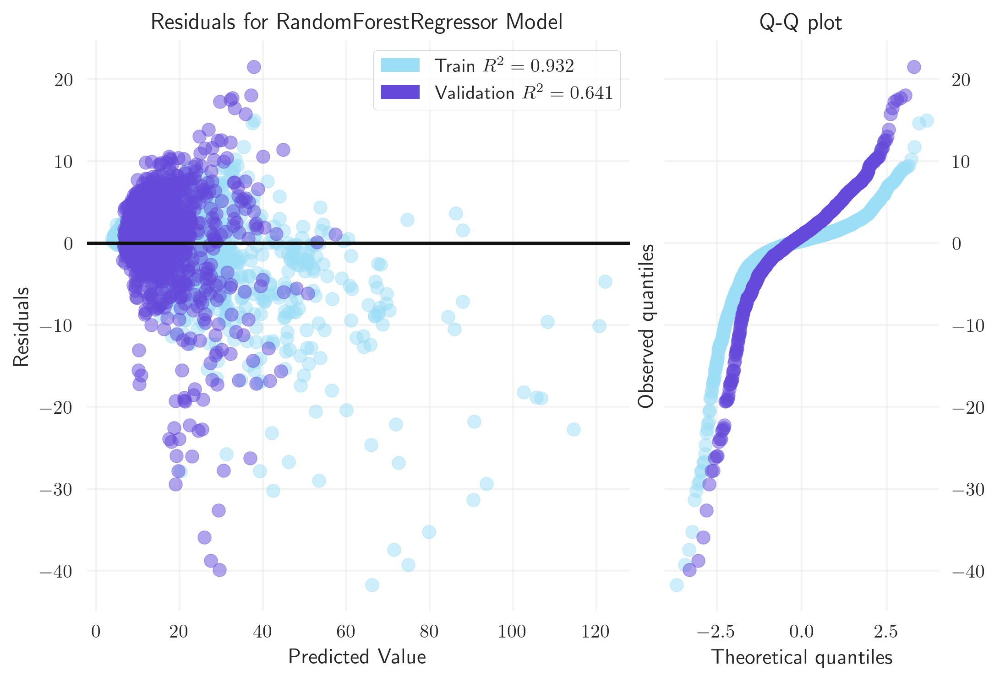

In [105]:
residuals_plot(rf_grid.best_estimator_, x, y, X_val, y_val)

## Extra Trees

In [64]:
%%time
from sklearn.ensemble import ExtraTreesRegressor

params={
    'n_estimators': np.arange(10, 100, 10),
    'min_samples_leaf': [1, 2, 3],
    'max_features': ['auto', 'sqrt', 'log2'],
    'ccp_alpha': np.arange(0, 1.1, 0.2)
}

extra_trees_grid = GridSearchCV(ExtraTreesRegressor(n_jobs=-1), params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

extra_trees_grid.fit(x, y)

extra_trees_scores = cross_validate(extra_trees_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

print_scores(extra_trees_scores)

print(extra_trees_grid.best_params_)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.66, 3.89, 6.33
{'ccp_alpha': 0.0, 'max_features': 'auto', 'min_samples_leaf': 3, 'n_estimators': 80}


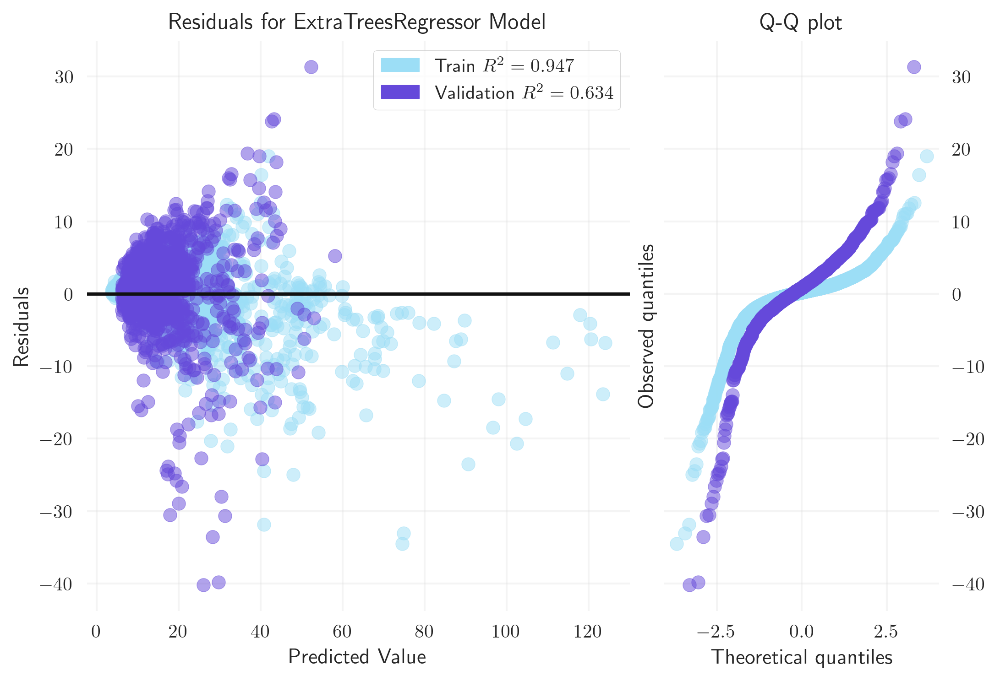

In [104]:
residuals_plot(extra_trees_grid.best_estimator_, x, y, X_val, y_val)

## Gradient Boost

In [71]:
%%time
from sklearn.ensemble import GradientBoostingRegressor

params={
    'n_estimators': np.arange(10, 100, 10),
    'loss': ['ls', 'lad', 'huber', 'quantile'],
    'learning_rate': np.arange(0.1, .21, .01),
    'min_samples_leaf': [1, 2, 3],
    'max_depth': [3, 4, 5],
    'max_features': ['auto', 'sqrt', 'log2'],
    'ccp_alpha': np.arange(0, 1.1, 0.2), 
    'alpha': np.arange(0.8, .96, 0.1)
}

# grad_boost_grid = GridSearchCV(GradientBoostingRegressor(), params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')


grad_boost = GradientBoostingRegressor()

grad_boost_scores = cross_validate(grad_boost, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

grad_boost.fit(x, y)

print_scores(grad_boost_scores)

/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.60, 4.13, 6.80


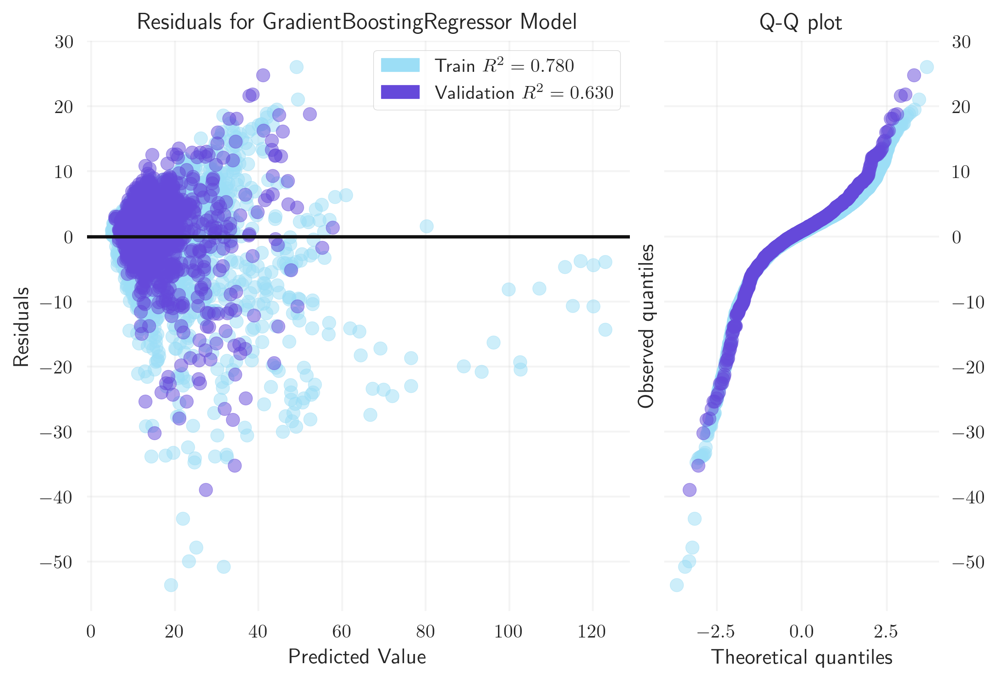

In [103]:
residuals_plot(grad_boost, x, y, X_val, y_val)

## XGBoost

In [80]:
%%time
import xgboost as xgb

params={
    'max_depth': [2, 3, 4, 5],
    'learning_rate': np.arange(0.1, .11, .1),
    'gamma': [0, 0.25, 1],
    'reg_lambda': [0, 1, 10],
    'scale_pos_weight': [1, 3, 5],
}

xgboost_grid = GridSearchCV(xgb.XGBRegressor(subsample=0.9, colsample_bytree=0.5), 
                            params, cv=10, scoring=scoring, refit='neg_root_mean_squared_error')

xgboost_grid.fit(x, y)

xgb_scores = cross_validate(xgboost_grid.best_estimator_, x, y, 
                                cv=stratified_kfold(y, 10), 
                                scoring=scoring)

print_scores(xgb_scores)

print(xgboost_grid.best_params_)


/Users/kyle/Documents/HoustonPM2.5/houston/lib/python3.9/site-packages/sklearn/model_selection/_split.py:666: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=10.
  warnings.warn(("The least populated class in y has only %d"


R2, MAE, RMSE
0.62, 4.08, 6.64
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 5, 'reg_lambda': 1, 'scale_pos_weight': 1}


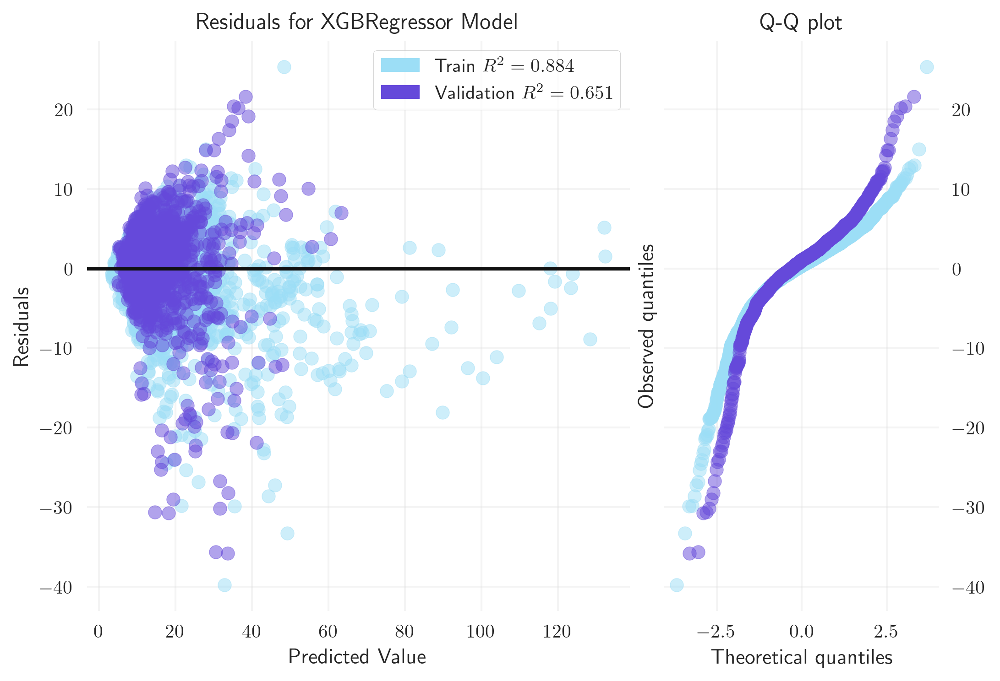

In [102]:
residuals_plot(xgboost_grid.best_estimator_, x, y, X_val, y_val)

# Model Score Plots

In [155]:
r2 = np.array([f'{i:.2f}' for i in reg_scores['test_r2']])
mae = np.array([f'{-i:.2f}' for i in reg_scores['test_neg_mean_absolute_error']])
rmse = np.array([f'{-i:.2f}' for i in reg_scores['test_neg_mean_absolute_error']])

pd.DataFrame({'R2': r2, 'MAE': mae, 'RMSE': rmse}, index=[f'Set {i}' for i in range(10)]).T

,Set 0,Set 1,Set 2,Set 3,Set 4,Set 5,Set 6,Set 7,Set 8,Set 9
R2,0.45,0.39,0.46,0.04,0.43,0.31,0.24,0.41,0.23,0.47
MAE,5.01,4.66,4.46,6.69,4.65,5.32,5.20,4.81,4.84,4.32
RMSE,5.01,4.66,4.46,6.69,4.65,5.32,5.20,4.81,4.84,4.32


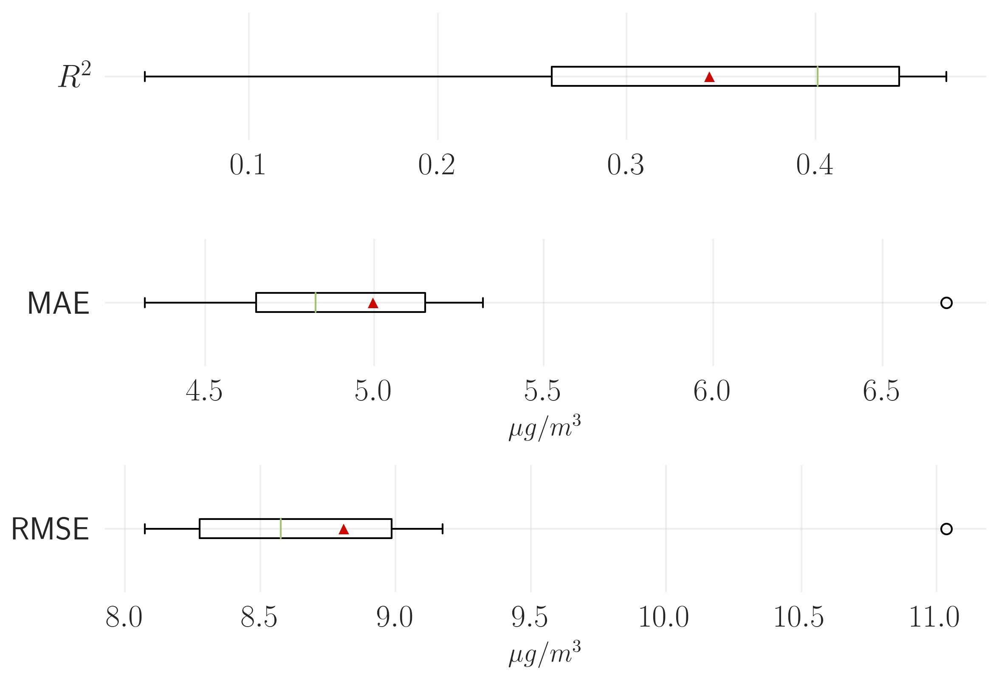

In [157]:
fig, (ax1, ax2, ax3) = plt.subplots(3, 1, dpi=300)

ax1.boxplot(reg_scores['test_r2'], labels=['$R^2$'], vert=False, showmeans=True)
ax2.boxplot(np.abs(reg_scores['test_neg_mean_absolute_error']), labels=['MAE'], vert=False, showmeans=True)
ax3.boxplot(np.abs(reg_scores['test_neg_root_mean_squared_error']), labels=['RMSE'], vert=False, showmeans=True)

ax2.set_xlabel(r'$\mu g/m^3$', fontsize=15)
ax3.set_xlabel(r'$\mu g/m^3$', fontsize=15)

for ax in [ax1, ax2, ax3]:
    ax.tick_params(axis='both', labelsize=18, width=0, which='both')
    ax.grid(True, alpha=0.3)
    
fig.tight_layout()

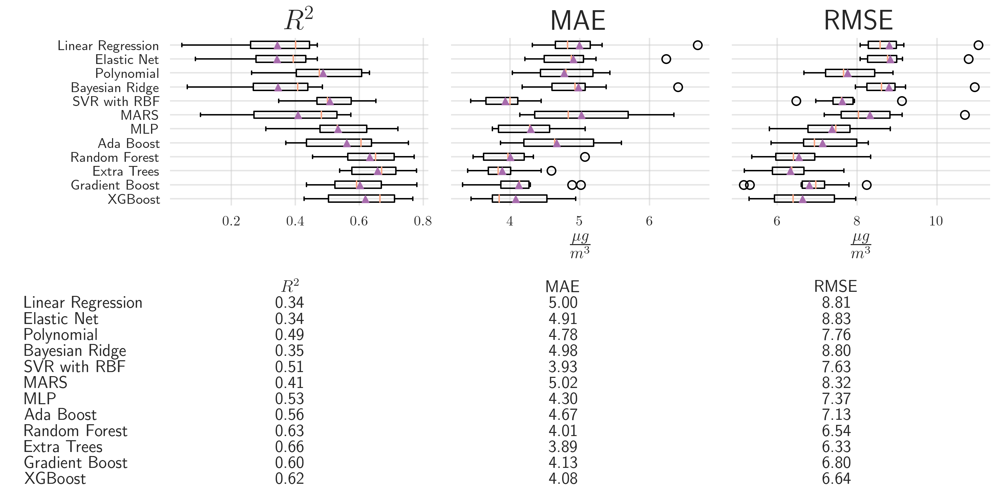

In [159]:
from matplotlib.gridspec import GridSpec

# if the kernel is restarted, the scores are loaded from disk in the Persistance section below
if stratified_scores is None and stratified_labels is None:
    # this requires that the notebook sections above for all models have been run
    stratified_scores = [reg_scores, elastic_scores, polynomial_scores, bayesian_ridge_scores, svr_scores, mars_scores, mlp_scores, ada_scores, rf_scores, extra_trees_scores, grad_boost_scores, xgb_scores]
    stratified_labels=['Linear Regression', 'Elastic Net', 'Polynomial', 'Bayesian Ridge', 'SVR with RBF', 'MARS', 'MLP', 'Ada Boost', 'Random Forest', 'Extra Trees', 'Gradient Boost', 'XGBoost']

grouped_boxplot_with_table(stratified_scores, stratified_labels)

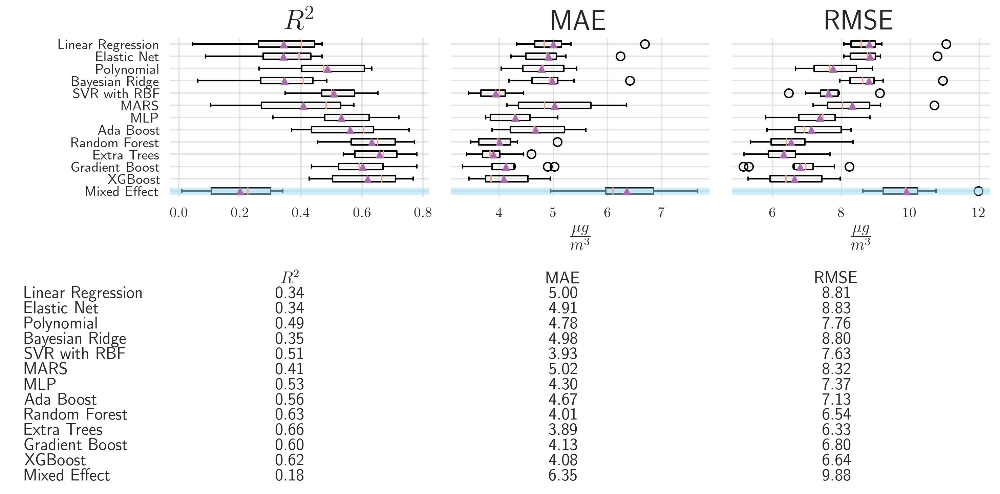

In [592]:
from matplotlib.gridspec import GridSpec

_scores = [reg_scores, elastic_scores, polynomial_scores, bayesian_ridge_scores, svr_scores, mars_scores, mlp_scores, ada_scores, rf_scores, extra_trees_scores, grad_boost_scores, xgb_scores, mixed_scores]
_labels=['Linear Regression', 'Elastic Net', 'Polynomial', 'Bayesian Ridge', 'SVR with RBF', 'MARS', 'MLP', 'Ada Boost', 'Random Forest', 'Extra Trees', 'Gradient Boost', 'XGBoost', 'Mixed Effect']

fig = plt.figure(figsize=(10, 5.09), dpi=300)

gs = GridSpec(2, 3, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])
ax4 = fig.add_subplot(gs[1, :])

fs=10

r2_boxes = score_boxplot('test_r2', *_scores, 
              title='$R^2$', labels=_labels, ax=ax1, 
              tick_fontsize=fs)

mae_boxes = score_boxplot('test_neg_mean_absolute_error', *_scores, 
              title='MAE', labels=_labels, ax=ax2, 
              tick_fontsize=fs)

rmse_boxes = score_boxplot('test_neg_root_mean_squared_error', *_scores, 
              title='RMSE', labels=_labels, ax=ax3, 
              tick_fontsize=fs)

for boxes in [r2_boxes, mae_boxes, rmse_boxes]:
    for mean in boxes['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in boxes['medians']:
        median.set_color('#FCA481')
#     for flier in boxes['fliers']:
#         flier.set_markerfacecolor('#9CDEF6')
#         flier.set_markeredgecolor('#A86CAD')

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()

ax2.set_yticklabels([])
ax3.set_yticklabels([])

plt.rc('text', usetex=True)
ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
ax3.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

ax4.axis('off')
ax4.axis('tight')

even_color='#9CDEF6'
odd_color='#6549DA'

cell_text = []
for score in _scores:
    vals = [f'{i:.2f}' for i in summarize_scores(score)]
    cell_text.append(vals)

table = ax4.table(cellText=cell_text,
                      rowLabels=_labels,
                      colLabels=['$R^2$', 'MAE', 'RMSE'],
                      loc='best', edges='open', cellLoc='center')

for ax in [ax1, ax2, ax3]:
    ax.axhline(y=13, color='#9CDEF6', alpha=0.5, lw=5)

fig.tight_layout()

# Persistence

In [613]:
import pickle

pickle.dump(
    {name: score for name, score in zip(stratified_labels, stratified_scores)},
    open('models/scores.p', 'wb'))

In [157]:
import pickle

with open('models/scores.p', 'rb') as file:
    a = pickle.load(file)
    stratified_labels, stratified_scores = map(list, zip(*a.items()))

In [614]:
from joblib import dump

models = {
    "Mixed Effect" : mixed_effect,
    "GradientBoosting": grad_boost,
    "XGBoost": xgboost_grid,
    "Extra Trees" : extra_trees_grid,
    "Random Forest": rf_grid,
    "Ada Boost": ada_grid,
    "MLP": mlp_grid,
    "MARS": mars_scores,
    "SVR": svr_grid,
    "Bayesian Ridge": bayesian_ridge,
    "Polynomial Regression": poly_grid,
    "Elastic Net": elastic,
    "Linear Regression": lm
}

for name, model in models.items():
    dump(model, f'models/{name}.joblib')

In [34]:
from joblib import load

mixed_effect = load("models/Mixed Effect.joblib")
grad_boost = load("models/GradientBoosting.joblib")
xgboost_grid = load("models/XGBoost.joblib")
extra_trees_grid = load("models/Extra Trees.joblib")
rf_grid = load("models/Random Forest.joblib")
ada_grid = load("models/Ada Boost.joblib")
mlp_grid = load("models/MLP.joblib")
mars_scores  = load("models/MARS.joblib")
svr_grid = load("models/SVR.joblib")
bayesian_ridge  = load("models/Bayesian Ridge.joblib")
poly_grid = load("models/Polynomial Regression.joblib")
elastic = load("models/Elastic Net.joblib")
lm = load("models/Linear Regression.joblib")

# Creating a model collection

The models above showed that there is a clear advantage to using random forest models. However, at least two things are hard to do automatically with the setup of this notebook:

1. using different data
2. changing between stratified k-fold and regular cross-validation

To remedy, I will make a model collection class which takes in some data and runs these models. There will be an option to use stratified k-fold or regular cross validation.

In [80]:
from sklearn.linear_model import LinearRegression, ElasticNetCV, BayesianRidge
from sklearn.svm import SVR
from pyearth import Earth

from sklearn.neural_network import MLPRegressor

from sklearn.ensemble import AdaBoostRegressor, RandomForestRegressor, ExtraTreesRegressor, GradientBoostingRegressor
from sklearn.tree import DecisionTreeRegressor

import xgboost as xgb

from sklearn.model_selection import cross_validate
from sklearn.model_selection import StratifiedKFold

from sklearn.pipeline import Pipeline

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures

import time

import pickle
from joblib import dump

from statsmodels.api import MixedLM
from sklearn.base import BaseEstimator, RegressorMixin


class MixedLMWrapper(BaseEstimator, RegressorMixin):
    """ 
    An sklearn-style wrapper for the statsmodels MixedLM regressor

    MixedLM documentation: https://www.statsmodels.org/stable/generated/statsmodels.regression.mixed_linear_model.MixedLM.html?highlight=mixedlm#statsmodels.regression.mixed_linear_model.MixedLM
    Code taken and modified from here: https://stackoverflow.com/a/48949667/5217293
    
    Attributes
    ----------
    formula : string
        The formula used by the MixedLM model. See the constructor for more details on this
    dependent_label : string
        The label of the dependent variable
    random_effect_variable : string
        The variable that will group the data to control for its random effect
    model_ : statsmodels.regression.mixed_linear_model.MixedLM
        The mixed effect model
        Set after calling fit()
    results_ : statsmodels.regression.mixed_linear_model.MixedLMResults
        The results of the mixed effect model fit.
        Set after calling fit()
    """
    def __init__(self, formula, dependent_label, random_effect_variable):
        """
        Initialize the MixedLM model

        Parameters
        ----------
        formula : pandas DataFrame
            A formula used to initialize the MixedLM using MixedLM.from_formula(): https://www.statsmodels.org/stable/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html#statsmodels.regression.mixed_linear_model.MixedLM.from_formula
            The formula is an R-style formula. Read more here: https://www.statsmodels.org/stable/examples/notebooks/generated/formulas.html
        dependent_label : string
            The label of the dependent variable
        random_effect_variable : string
            The variable that will group the data to control for its random effect
        """
        self.formula = formula
        self.dependent_label = dependent_label
        self.random_effect_variable = random_effect_variable

    def fit(self, X, y):
        """
        Fit the MixedLM model

        Parameters
        ----------
        X : array_like
            The covariates used to predict `y`
        y : array_like
            The values that should be predicted
        """
        data = pd.concat([pd.DataFrame(X), pd.Series(y)], axis=1)
        data.columns = X.columns.tolist() + [self.dependent_label]
        
        self.model_ = MixedLM.from_formula(self.formula, 
                                           data=data, 
                                           groups=self.random_effect_variable)
        self.results_ = self.model_.fit()
        
    def predict(self, X):
        """
        Make a prediction with the fitted model

        Parameters
        ----------
        X : array_like
            The covariates used to make a prediction
        """
        return self.results_.predict(X)
    
    def summary(self):
        """
        Print a summary of the fitted results 
        
        See the MixedLMResults.summary documentation for more information: https://www.statsmodels.org/stable/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.summary.html#statsmodels.regression.mixed_linear_model.MixedLMResults.summary
        """
        return self.results_.summary()

class ModelCollection:
    """
    A class which helps to train and score a subset of sklearn algorithms.
    
    This class is not meant to do all of the work in terms of hyperparameter tuning,
    merely it serves to provide convenience for fitting and collecting cross-validated scores
    of several model in a few lines of code. Optimizing parameters should be done by hand and the
    model in question should be replaced in the dictionary. Note that any model can be added to the
    models attribute so long as the model provides the regular sklearn api functions of fit() and score()
    
    Below is a listing of class attributes which can be modified directly but are not 
    changeable via the constructor. See the constructor docstring for more variables
    that can be set.
    
    Attributes
    ----------
    scoring : array of strings
        passed to sklearn.model_selection.cross_validate's scoring parameter
    models : dictionary of strings and models
        models presenting an sklearn-like API
    scores_ : dictionary
        keys are strings of the model names with values indicating the r2 score, 
        this attribute is set after calling compute_scores()
    cross_val_scores_ : dictionary
        keys are strings of the model names with values being the 
        output of sklearn.model_selection.cross_validate
        this attribute is set after calling compute_cross_validation_scores()
    """
    
    def __init__(self, x, y, cv=10, stratify=False):
        """
        Initialize the necessary data for this class

        Parameters
        ----------
        x : pandas DataFrame
            the covariates used to predict x
        y : array_like
            the dependant variable being predicted
        cv : int, optional default 10
            the number of folds to use for cross validation. If stratify is True, this will also determine
            the number of bins to use to stratify y
        stratify : boolean, optional default False
            if True, y will be stratified with pandas.cut using the cv as the number of bins so that
            stratified cross validation will be done. 
            Read more here: https://stackoverflow.com/a/54946733/5217293
        """
        self.x = x
        self.y = y
        
        self.scoring = ['r2', 'neg_mean_absolute_error', 'neg_root_mean_squared_error']
        
        self.cv = cv
        self.stratified_kfold = stratify
        
        self._setup_models()
    
    def fit(self):
        """
        Fit each model with the data passed into the constructor
        
        Returns
        ----------
        fit_times: dictionary
            keys are strings of the model names, values are floats representing the time taken
            to fit the model in seconds
        """
        fit_times = {}
        
        for name, model in self.models.items():
            start = time.time()
            
            self.models[name] = model.fit(self.x, self.y)
            
            # in seconds
            fit_times[name] = time.time() - start
        
        return fit_times
    
    def compute_cross_validation_scores(self):
        """
        Compute the cross validated scores using sklearn.model_selection.cross_validate for
        each model.
        
        This method sets the cross_val_scores_ attribute on this object.
        
        Returns
        ----------
        cross_val_scores_ : dictionary
            keys are strings of the model names with values being the output 
            of sklearn.model_selection.cross_validate
        """
        self.cross_val_scores_ = {}
        for name, model in self.models.items():
            self.cross_val_scores_[name] = cross_validate(model, 
                                          self.x, self.y, 
                                          cv = self._get_cross_validation(), 
                                          scoring = self.scoring)
        return self.cross_val_scores_
    
    def compute_scores(self, x, y):
        """
        Compute the cross validated scores using sklearn.model_selection.cross_validate for
        each model.
        
        This method sets the cross_val_scores_ attribute on this object.
        
        Returns
        ----------
        scores_ : dictionary
            keys are strings of the model names with values indicating the r2 score, 
            this attribute is set after calling compute_scores()
        """
        self.scores_ = {}
        for name, model in self.models.items():
            scores_[name] = model.score(x, y)
            
        return scores_
    
    def save_models(self, directory='', prefix=''):
        """
        Save all of the models to the disk using joblib as recommended 
        by sklearn.
        
        Read more here: https://sklearn.org/modules/model_persistence.html
        
        Parameters
        ----------
        directory : string, optional default ''
            The directory that all of the models will be saved to.
            This can be a file system path
        prefix : string, optional default ''
            The prefix to prepend to each model name
        """
        for name, model in self.models.items():
            dump(model, f'{directory}/{prefix}{name}.joblib')
    
    def _get_cross_validation(self):
        """
        Return a cross validation depending on the value of self.stratified_kfold
        
        Returns
        ----------
        cv : int or an sklearn StratifiedKFold
        """
        if self.stratified_kfold:
            return self._stratified_kfold()
        return self.cv
    
    def _setup_models(self):
        """
        Initialize the dictionary of models
        
        
        The individual models can be modified after this class is constructed by replacing
        values in self.models
        """
        #  models that will be placed into a pipeline
        elastic = ElasticNetCV(cv=10, 
                       l1_ratio=np.arange(0.1, 1.1, .1),
                       max_iter=10000
                      )
        mlp = MLPRegressor(max_iter=2000, early_stopping=True)

        self.models = {
            'Linear Regression': LinearRegression(),
            'Elastic Net' : Pipeline([('scaler', StandardScaler()), ('elastic', elastic)]),
            'Polynomial' : Pipeline([('poly', PolynomialFeatures()), ('linear', LinearRegression())]),
            'Bayesian Ridge' : BayesianRidge(),
            'SVR with RBF' : Pipeline([('scaler', StandardScaler()), ('svr', SVR())]),
            'MARS' : Earth(),
            'MLP' : Pipeline([('scaler', StandardScaler()), ('mlp', mlp)]),
            'Ada Boost' : AdaBoostRegressor(),
            'Random Forest' : RandomForestRegressor(n_jobs=-1),
            'Extra Trees' : ExtraTreesRegressor(n_jobs=-1),
            'Gradient Boost' : GradientBoostingRegressor(),
            'XGBoost' : xgb.XGBRegressor(subsample=0.9, colsample_bytree=0.5)
            
        }

    def _stratified_kfold(self):
        # stratified k-fold cross validation: https://stackoverflow.com/a/54946733/5217293
        y_cat = pd.cut(self.y, self.cv, labels=range(self.cv))
        return StratifiedKFold(self.cv).split(self.x, y_cat)
    
class ModelStack():
    """
    A class which will stack the "best" models in a ModelCollection.
    
    To better estimate the dependent variable, the fitted models can be stacked.
    The function that will do the stacking can be any function that follows the sklearn API.
    By default, the stacking function is a multiple linear regressor and method 1 below is used.

    Stacking can be done in 2 ways:
        1. The predicted values from the selected models will be run through the stacking model
            and regressed against the predicted values.
        2. The residuals of the best models will be fitted to the stacking model.
    
    
    Attributes
    ----------
    mc : ModelCollection
        The fitted ModelCollection passed to the constructor
    stacker : object
        An estimator with an sklearn-like API
    estimation : string, one of ["predicted", "residuals"]
        "predicted" means that the stacker will be fitted with the predictions of each model, regressing
        against the actual value
        "residuals" means that the stacker will be regressed against the residuals
    """
    
    def __init__(self, mc):
        """
        Initialize the necessary data for this class

        Parameters
        ----------
        mc : ModelCollection
            A scored and fitted ModelCollection
        """
        pass

# Without Stratified K-Fold

In [335]:
import warnings

mc = ModelCollection(x, y)
            
mc.models['MLP'] = Pipeline([
    ('scaler', StandardScaler()),
    ('mlp', MLPRegressor(max_iter=2000, early_stopping=True, 
                         beta_1=0.6, beta_2=0.9, hidden_layer_sizes = [10, 10, 10, 10, 10]))
])
                
mc.models['Ada Boost'] = AdaBoostRegressor(
    base_estimator = DecisionTreeRegressor(max_depth=5), 
    learning_rate =  1.5, 
    loss = 'exponential', 
    n_estimators = 10)

mc.models['Random Forest'] = RandomForestRegressor(
    n_jobs = -1,
    ccp_alpha = 0.0,
    max_features = 'log2', 
    min_samples_leaf = 2, 
    min_samples_split = 2, 
    n_estimators = 70)

mc.models['Extra Trees'] = ExtraTreesRegressor(
    n_jobs=-1, 
    ccp_alpha = 0.0,
    max_features = 'auto',
    min_samples_leaf = 3,
    n_estimators = 80
)

mc.models['XGBoost'] = xgb.XGBRegressor(
    subsample=0.9, 
    colsample_bytree=0.5,
    gamma = 0,
    learning_rate = 0.1,
    max_depth = 5,
    reg_lambda = 1, 
    scale_pos_weight = 1
)

# silence warnings thrown by pyearth's use of numpy's linalg.lstsq
with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    regularcv_scores = mc.compute_cross_validation_scores()
    fit_times = mc.fit()

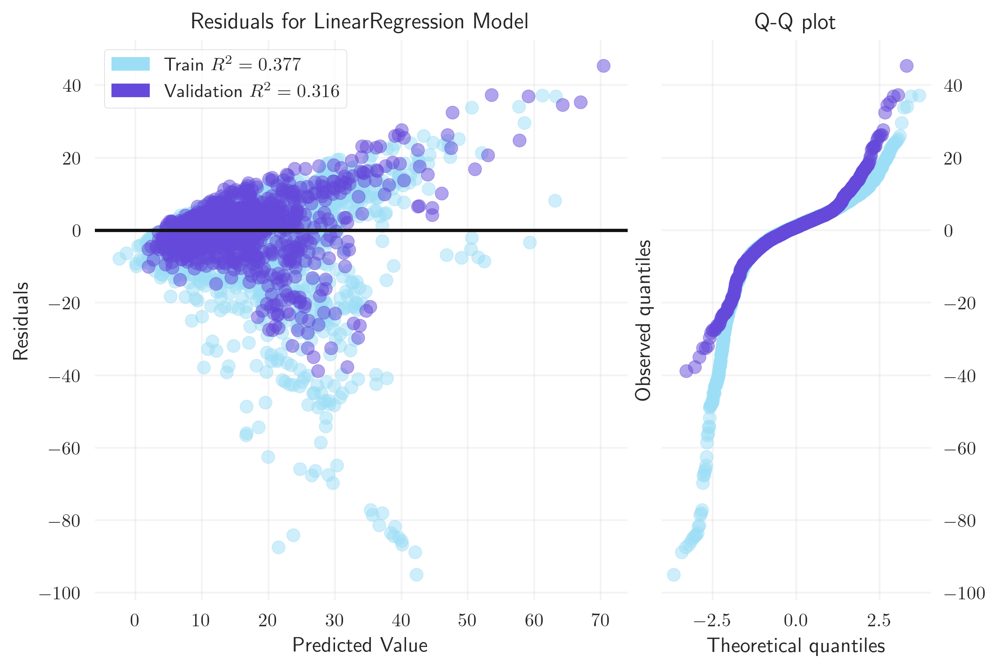

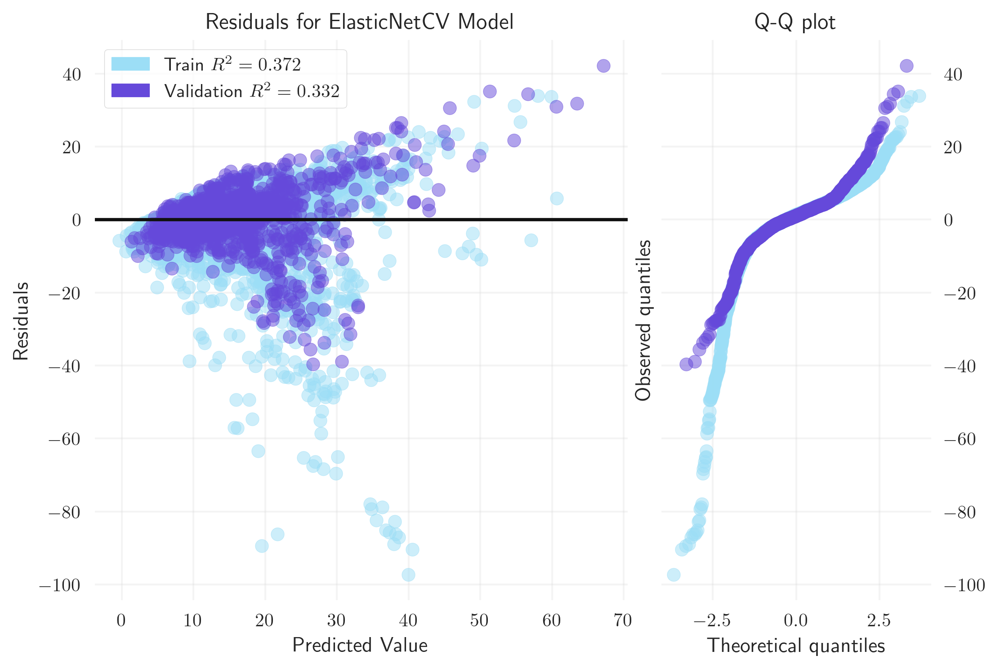

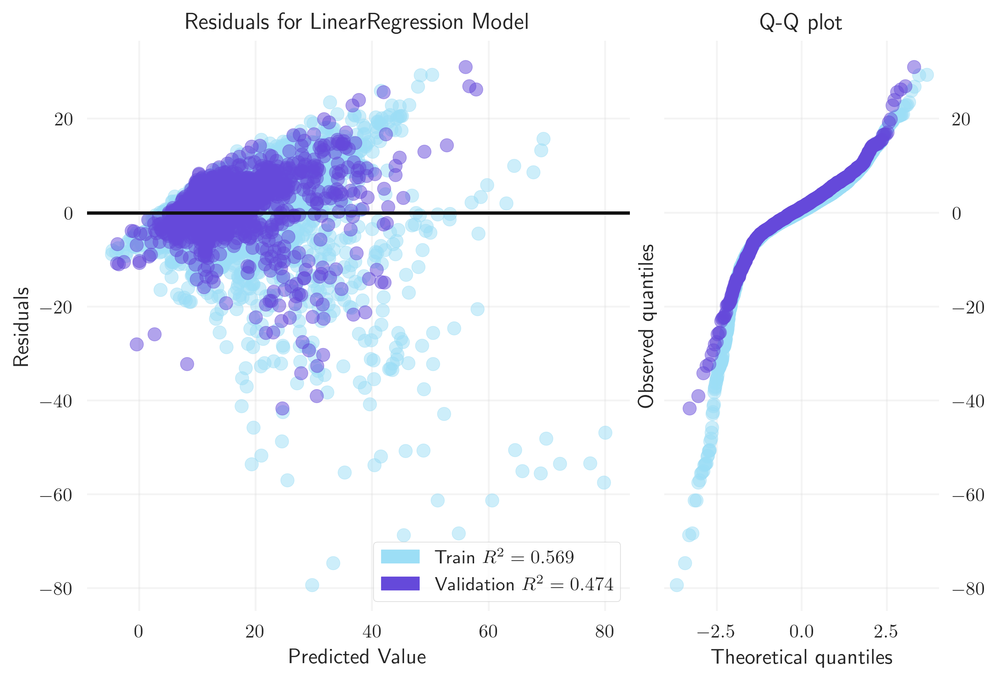

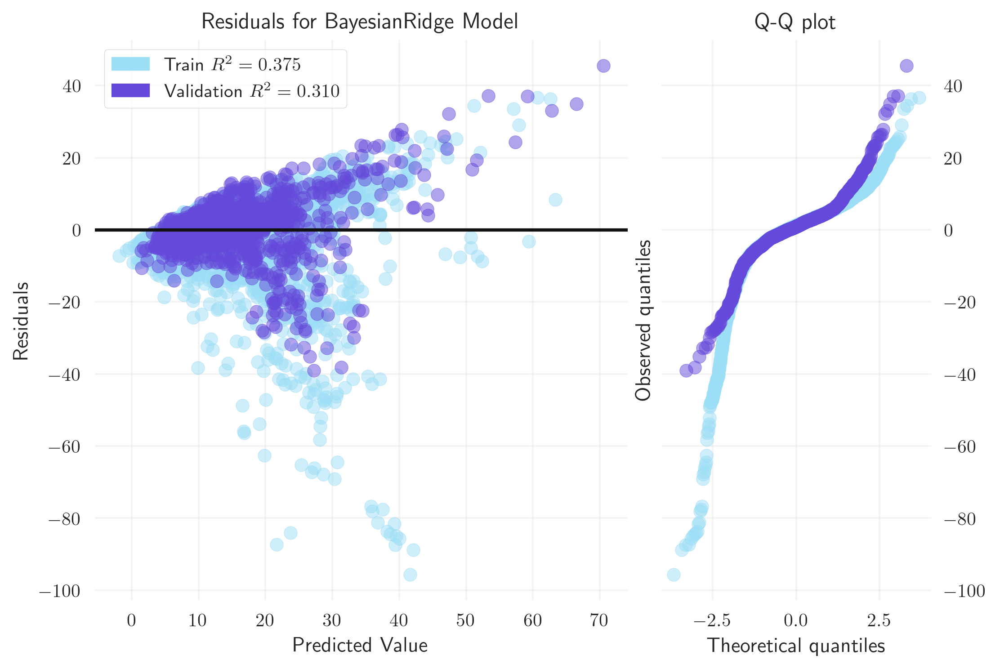

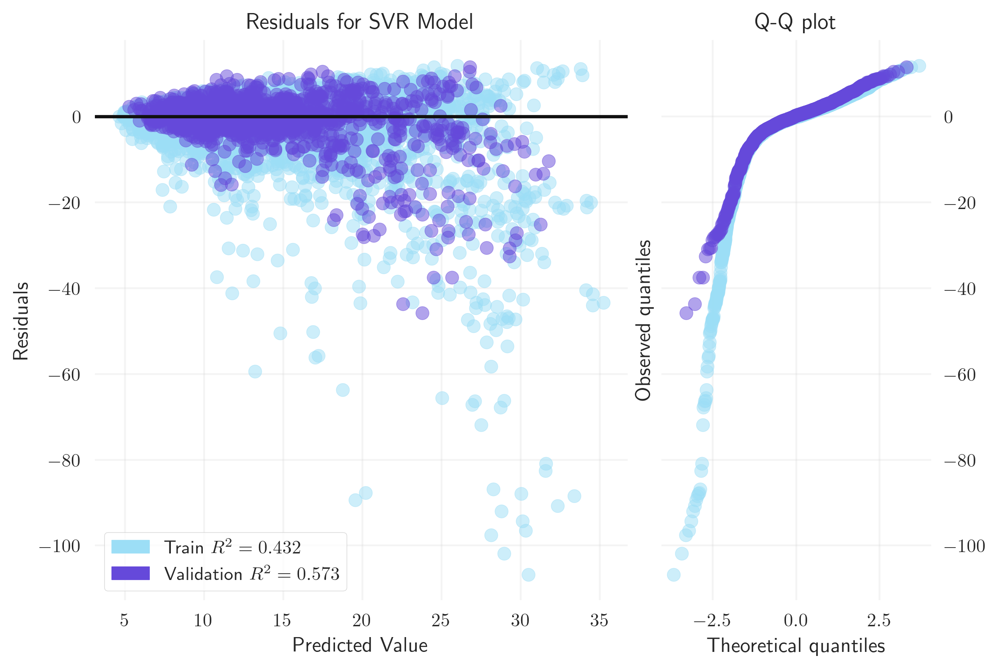

...

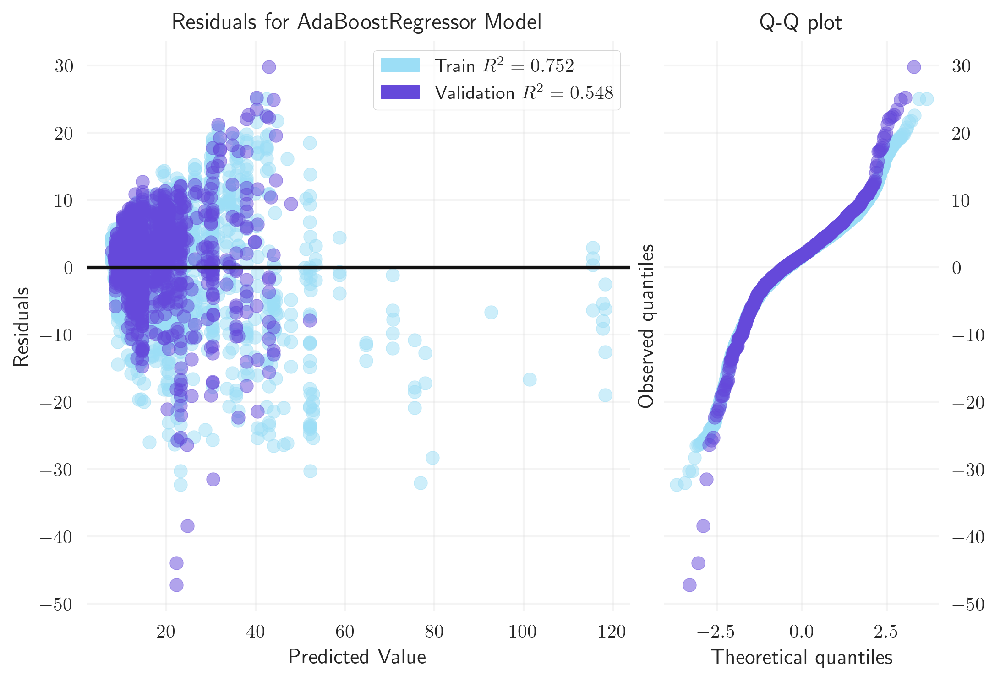

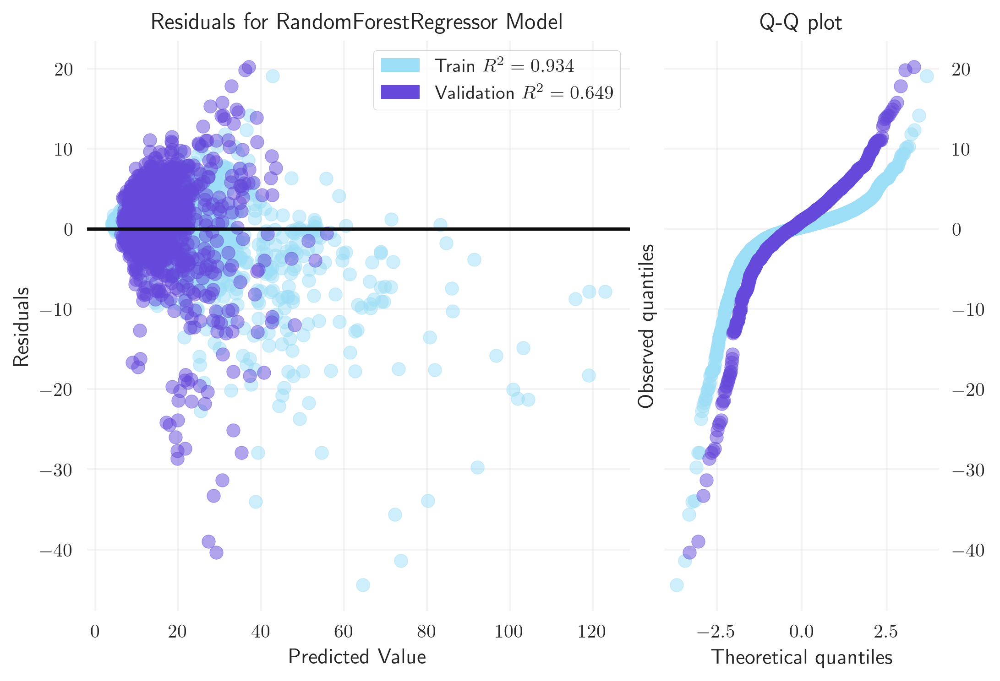

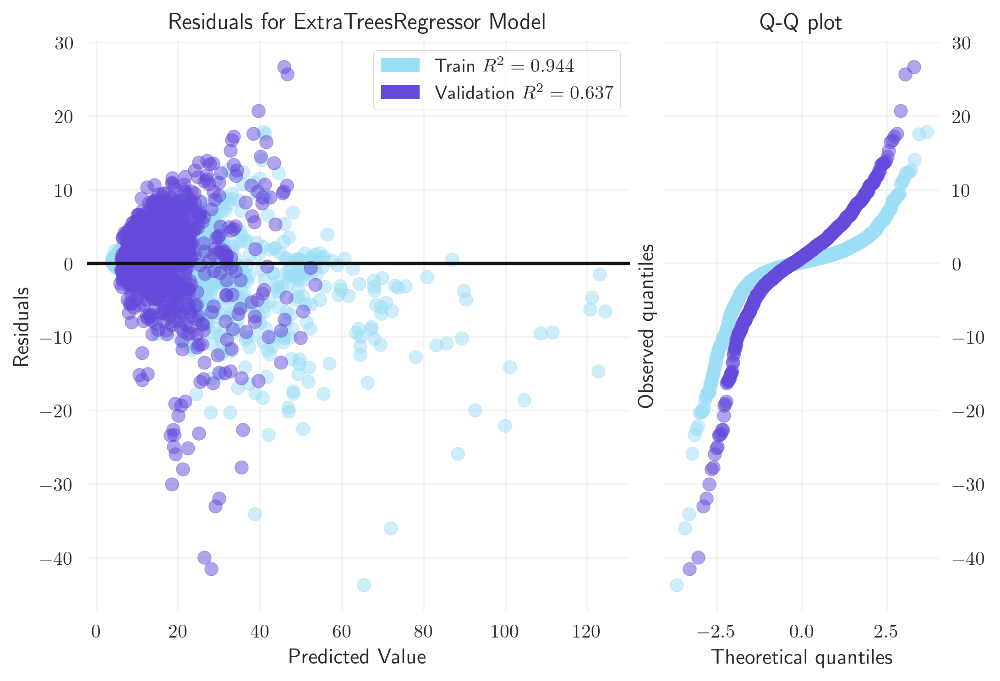

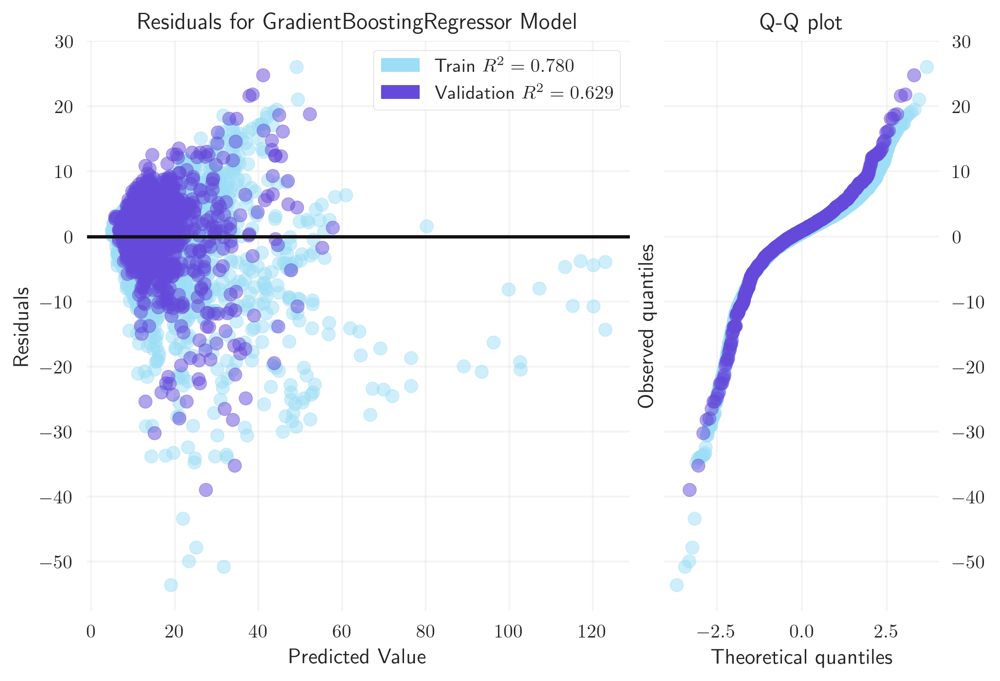

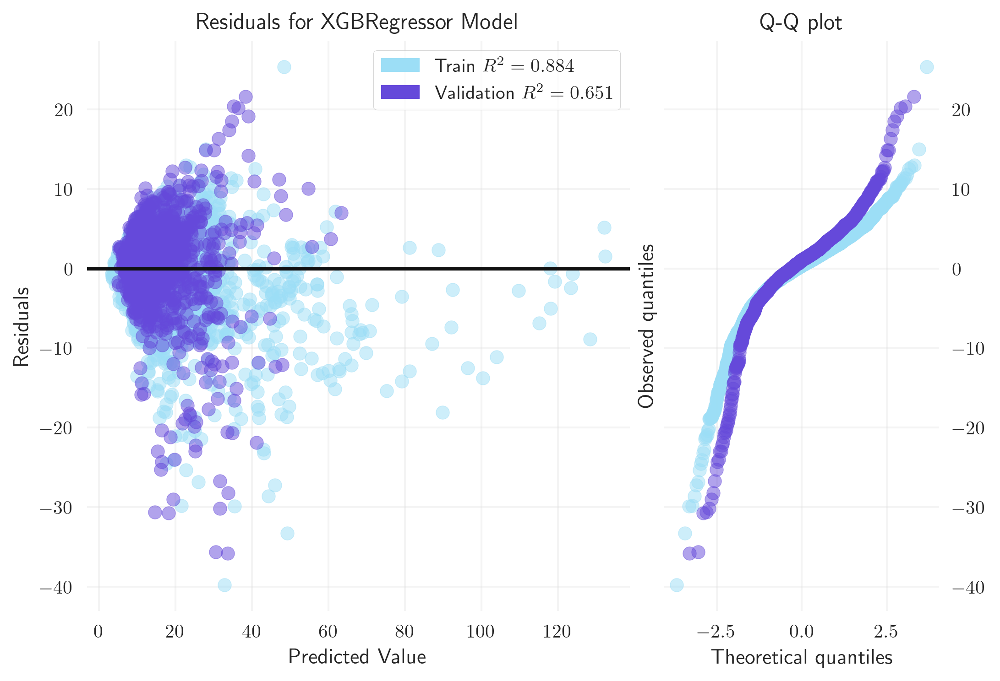

In [336]:
from sklearn.utils.validation import check_is_fitted

for name, model in mc.models.items():
    residuals_plot(model, x, y, X_val, y_val)

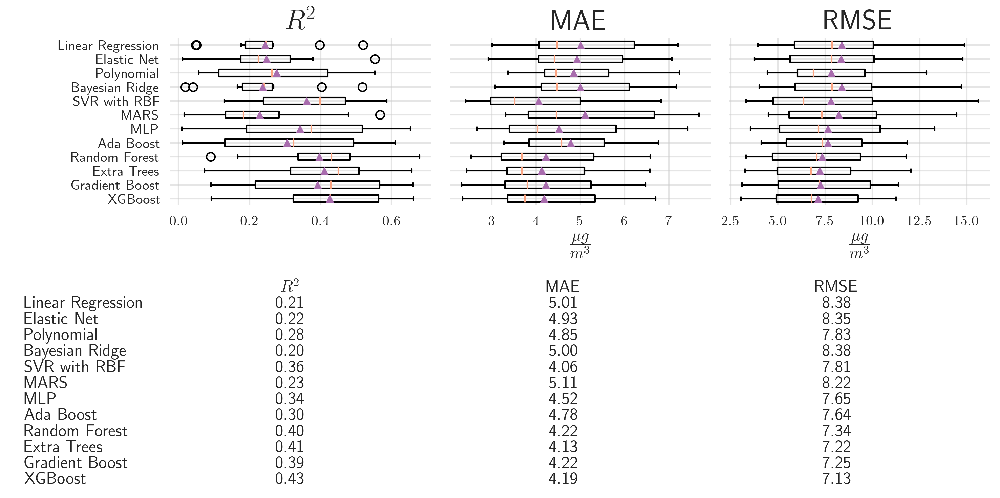

In [337]:
from matplotlib.gridspec import GridSpec

labels, scores = map(list, zip(*regularcv_scores.items()))

fig = plt.figure(figsize=(10, 5.09), dpi=300)

gs = GridSpec(2, 3, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[0, 2])
ax4 = fig.add_subplot(gs[1, :])

fs=10

r2_boxes = score_boxplot('test_r2', *scores, 
              title='$R^2$', labels=labels, ax=ax1, 
              tick_fontsize=fs)

mae_boxes = score_boxplot('test_neg_mean_absolute_error', *scores, 
              title='MAE', labels=labels, ax=ax2, 
              tick_fontsize=fs)

rmse_boxes = score_boxplot('test_neg_root_mean_squared_error', *scores, 
              title='RMSE', labels=labels, ax=ax3, 
              tick_fontsize=fs)

for boxes in [r2_boxes, mae_boxes, rmse_boxes]:
    for mean in boxes['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in boxes['medians']:
        median.set_color('#FCA481')
#     for flier in boxes['fliers']:
#         flier.set_markerfacecolor('#9CDEF6')
#         flier.set_markeredgecolor('#A86CAD')

ax1.invert_yaxis()
ax2.invert_yaxis()
ax3.invert_yaxis()

ax2.set_yticklabels([])
ax3.set_yticklabels([])

plt.rc('text', usetex=True)
ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
ax3.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

ax4.axis('off')
ax4.axis('tight')

even_color='#9CDEF6'
odd_color='#6549DA'

cell_text = []
for score in scores:
    vals = [f'{i:.2f}' for i in summarize_scores(score)]
    cell_text.append(vals)

table = ax4.table(cellText=cell_text,
                      rowLabels=labels,
                      colLabels=['$R^2$', 'MAE', 'RMSE'],
                      loc='best', edges='open', cellLoc='center')

fig.tight_layout()

In [386]:
from scipy.stats import ttest_ind

stratified_scores_dict = {label: score for label, score in zip(stratified_labels, stratified_scores)}

tests = {'R2' : 'test_r2', 'MAE' : 'test_neg_mean_absolute_error', 'RMSE' : 'test_neg_root_mean_squared_error'}

model_name = []
ts = []
ps = []
stratified_average = []
regularcv_average = []
test_names = []

for model in regularcv_scores.keys():
    for test_name, test_key in tests.items():
        stratified_vals = np.abs(stratified_scores_dict[model][test_key])
        regularcv_vals = np.abs(regularcv_scores[model][test_key])
        t, p = ttest_ind(stratified_vals, regularcv_vals)
        
        test_names.append(test_name)
        model_name.append(model)
        ts.append(t)
        ps.append(p)
        stratified_average.append(stratified_vals.mean())
        regularcv_average.append(regularcv_vals.mean())

In [387]:
t_tests = pd.DataFrame(
    {
        'Model' : model_name, 
        'Stratified Average' : stratified_average, 
        'Regular CV Average' : regularcv_average,
        'Test' : test_names,
        'T Statistic' : ts,
        'P value' : ps
    })

In [388]:
t_tests[t_tests['Test'] == 'R2']

,Model,Stratified Average,Regular CV Average,Test,T Statistic,P value
0,Linear Regression,0.34,0.24,R2,1.60,0.13
3,Elastic Net,0.34,0.25,R2,1.54,0.14
6,Polynomial,0.49,0.28,R2,3.06,0.01
9,Bayesian Ridge,0.35,0.24,R2,1.72,0.10
12,SVR with RBF,0.51,0.36,R2,2.58,0.02
15,MARS,0.41,0.23,R2,2.34,0.03
18,MLP,0.53,0.34,R2,2.32,0.03
21,Ada Boost,0.56,0.31,R2,3.14,0.01
24,Random Forest,0.63,0.40,R2,3.63,0.00
27,Extra Trees,0.66,0.41,R2,4.15,0.00


In [389]:
t_tests[t_tests['Test'] == 'MAE']

,Model,Stratified Average,Regular CV Average,Test,T Statistic,P value
1,Linear Regression,5.00,5.01,MAE,-0.02,0.98
4,Elastic Net,4.91,4.93,MAE,-0.04,0.97
7,Polynomial,4.78,4.85,MAE,-0.18,0.86
10,Bayesian Ridge,4.98,5.00,MAE,-0.04,0.97
13,SVR with RBF,3.93,4.06,MAE,-0.26,0.80
16,MARS,5.02,5.11,MAE,-0.15,0.88
19,MLP,4.30,4.52,MAE,-0.43,0.67
22,Ada Boost,4.67,4.78,MAE,-0.27,0.79
25,Random Forest,4.01,4.22,MAE,-0.48,0.64
28,Extra Trees,3.89,4.13,MAE,-0.57,0.58


In [390]:
t_tests[t_tests['Test'] == 'RMSE']

,Model,Stratified Average,Regular CV Average,Test,T Statistic,P value
2,Linear Regression,8.81,8.38,RMSE,0.37,0.71
5,Elastic Net,8.83,8.35,RMSE,0.41,0.68
8,Polynomial,7.76,7.83,RMSE,-0.07,0.94
11,Bayesian Ridge,8.80,8.38,RMSE,0.37,0.72
14,SVR with RBF,7.63,7.81,RMSE,-0.14,0.89
17,MARS,8.32,8.22,RMSE,0.09,0.93
20,MLP,7.37,7.65,RMSE,-0.25,0.81
23,Ada Boost,7.13,7.64,RMSE,-0.56,0.58
26,Random Forest,6.54,7.34,RMSE,-0.78,0.44
29,Extra Trees,6.33,7.22,RMSE,-0.92,0.37


In [403]:
t_tests[t_tests['Test'] == 'R2'][['Stratified Average', 'Regular CV Average', 'T Statistic', 'P value']].values

array([[3.43664574e-01, 2.43901071e-01, 1.60009557e+00, 1.26981927e-01],
       [3.42254299e-01, 2.47762861e-01, 1.54292109e+00, 1.40247922e-01],
       [4.86379117e-01, 2.76464187e-01, 3.05557895e+00, 6.80906729e-03],
       [3.45846932e-01, 2.37109257e-01, 1.72220800e+00, 1.02170238e-01],
       [5.08103819e-01, 3.61115300e-01, 2.57563274e+00, 1.90494523e-02],
       [4.08557715e-01, 2.28902905e-01, 2.33578216e+00, 3.12729951e-02],
       [5.32830692e-01, 3.41953606e-01, 2.32193338e+00, 3.21657184e-02],
       [5.60872223e-01, 3.05916063e-01, 3.13572538e+00, 5.71439382e-03],
       [6.32520615e-01, 3.96288651e-01, 3.62606650e+00, 1.93184745e-03],
       [6.57536661e-01, 4.10814131e-01, 4.15074262e+00, 6.00481835e-04],
       [6.02571616e-01, 3.91868521e-01, 2.67049340e+00, 1.55977853e-02],
       [6.19350596e-01, 4.25794063e-01, 2.86272112e+00, 1.03445559e-02]])

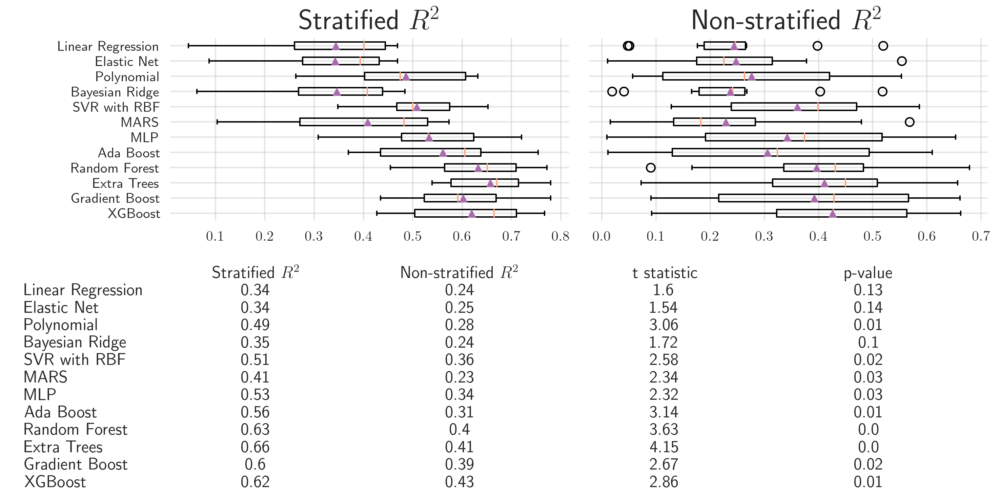

In [411]:
from matplotlib.gridspec import GridSpec

cv_labels, cv_scores = map(list, zip(*regularcv_scores.items()))
strat_labels, strat_scores = map(list, zip(*stratified_scores_dict.items()))

fig = plt.figure(figsize=(10, 5.09), dpi=300)

gs = GridSpec(2, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax4 = fig.add_subplot(gs[1, :])

fs=10

strat_r2_boxes = score_boxplot('test_r2', *strat_scores, 
              title='Stratified $R^2$', labels=strat_labels, ax=ax1, 
              tick_fontsize=fs)

cv_r2_boxes = score_boxplot('test_r2', *cv_scores, 
              title='Non-stratified $R^2$', labels=cv_labels, ax=ax2, 
              tick_fontsize=fs)


for boxes in [strat_r2_boxes, cv_r2_boxes]:
    for mean in boxes['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in boxes['medians']:
        median.set_color('#FCA481')
#     for flier in boxes['fliers']:
#         flier.set_markerfacecolor('#9CDEF6')
#         flier.set_markeredgecolor('#A86CAD')

ax1.invert_yaxis()
ax2.invert_yaxis()

ax2.set_yticklabels([])

# plt.rc('text', usetex=True)
# ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
# ax3.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

ax4.axis('off')
ax4.axis('tight')

cell_text = t_tests[t_tests['Test'] == 'R2'][['Stratified Average', 'Regular CV Average', 'T Statistic', 'P value']].values
cell_text = np.round(cell_text, 2)

table = ax4.table(cellText=cell_text,
                      rowLabels=labels,
                      colLabels=['Stratified $R^2$', 'Non-stratified $R^2$', 't statistic', 'p-value'],
                      loc='best', edges='open', cellLoc='center')

fig.tight_layout()

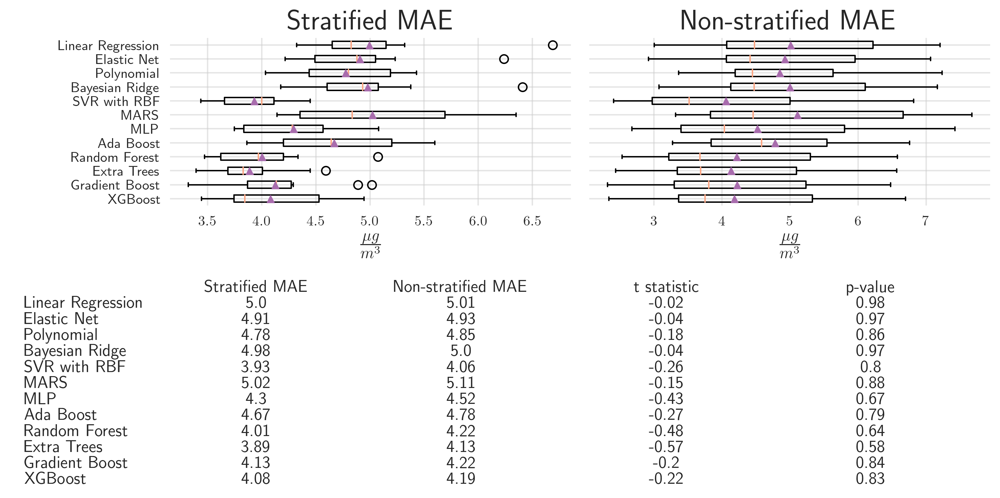

In [416]:
fig = plt.figure(figsize=(10, 5.09), dpi=300)

gs = GridSpec(2, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax4 = fig.add_subplot(gs[1, :])

fs=10

strat_mae_boxes = score_boxplot('test_neg_mean_absolute_error', *strat_scores, 
              title='Stratified MAE', labels=strat_labels, ax=ax1, 
              tick_fontsize=fs)

cv_mae_boxes = score_boxplot('test_neg_mean_absolute_error', *cv_scores, 
              title='Non-stratified MAE', labels=cv_labels, ax=ax2, 
              tick_fontsize=fs)


for boxes in [strat_mae_boxes, cv_mae_boxes]:
    for mean in boxes['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in boxes['medians']:
        median.set_color('#FCA481')
#     for flier in boxes['fliers']:
#         flier.set_markerfacecolor('#9CDEF6')
#         flier.set_markeredgecolor('#A86CAD')

ax1.invert_yaxis()
ax2.invert_yaxis()

ax2.set_yticklabels([])

plt.rc('text', usetex=True)
ax1.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

ax4.axis('off')
ax4.axis('tight')

cell_text = t_tests[t_tests['Test'] == 'MAE'][['Stratified Average', 'Regular CV Average', 'T Statistic', 'P value']].values
cell_text = np.round(cell_text, 2)

table = ax4.table(cellText=cell_text,
                      rowLabels=labels,
                      colLabels=['Stratified MAE', 'Non-stratified MAE', 't statistic', 'p-value'],
                      loc='best', edges='open', cellLoc='center')

fig.tight_layout()

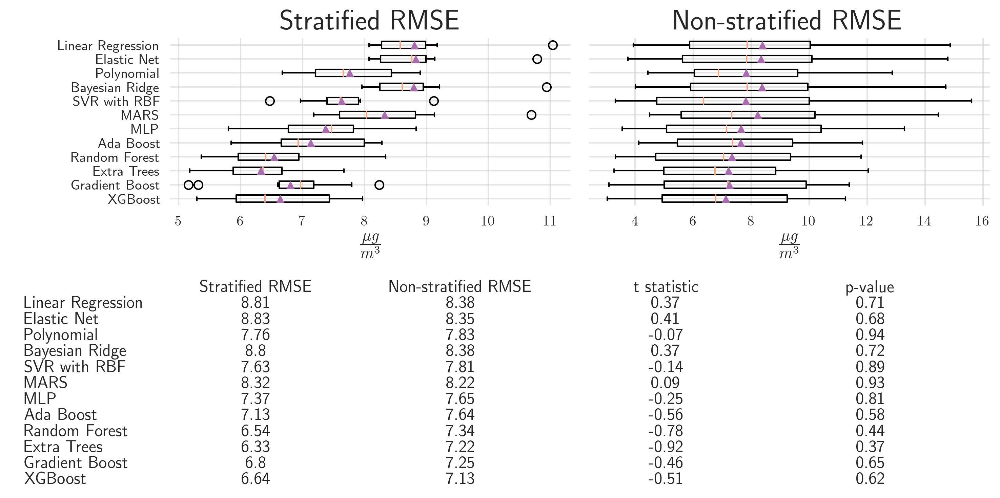

In [417]:
fig = plt.figure(figsize=(10, 5.09), dpi=300)

gs = GridSpec(2, 2, figure=fig)
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax4 = fig.add_subplot(gs[1, :])

fs=10

strat_rmse_boxes = score_boxplot('test_neg_root_mean_squared_error', *strat_scores, 
              title='Stratified RMSE', labels=strat_labels, ax=ax1, 
              tick_fontsize=fs)

cv_rmse_boxes = score_boxplot('test_neg_root_mean_squared_error', *cv_scores, 
              title='Non-stratified RMSE', labels=cv_labels, ax=ax2, 
              tick_fontsize=fs)


for boxes in [strat_rmse_boxes, cv_rmse_boxes]:
    for mean in boxes['means']:
        mean.set_markerfacecolor('#A86CAD')
    for median in boxes['medians']:
        median.set_color('#FCA481')
#     for flier in boxes['fliers']:
#         flier.set_markerfacecolor('#9CDEF6')
#         flier.set_markeredgecolor('#A86CAD')

ax1.invert_yaxis()
ax2.invert_yaxis()

ax2.set_yticklabels([])

plt.rc('text', usetex=True)
ax1.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)
ax2.set_xlabel(r'$\frac{\mu g}{m^3}$', fontsize=16)

ax4.axis('off')
ax4.axis('tight')

cell_text = t_tests[t_tests['Test'] == 'RMSE'][['Stratified Average', 'Regular CV Average', 'T Statistic', 'P value']].values
cell_text = np.round(cell_text, 2)

table = ax4.table(cellText=cell_text,
                      rowLabels=labels,
                      colLabels=['Stratified RMSE', 'Non-stratified RMSE', 't statistic', 'p-value'],
                      loc='best', edges='open', cellLoc='center')

fig.tight_layout()